<a href="https://colab.research.google.com/github/AbhinavRajUpman/Coursera_Test/blob/main/Experiment_Anime_GAN_final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Prepare Import and stuffs

In [1]:
!pip install -U -q PyDrive
from pydrive.auth import GoogleAuth

from pydrive.drive import GoogleDrive
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials


In [2]:
from keras.optimizers import Adam, RMSprop

from shutil import copyfile
import os
from tensorflow.keras.utils import load_img ,img_to_array
import matplotlib.pyplot as plt

import keras
from keras import layers
import os
import tensorflow as tf
from keras.layers import BatchNormalization
import numpy as np
from skimage.io import imread
from skimage.transform import resize
from keras.utils.vis_utils import plot_model
import numpy as np
from skimage.io import imread
from skimage.transform import resize
import numpy as np
from tqdm import tqdm_notebook
import os 
from keras.preprocessing import image
from tqdm import tqdm_notebook



In [3]:
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

In [4]:
download = drive.CreateFile({'id': '1jdJXkQIWVGOeb0XJIXE3YuZQeiEPd8rM'})
download.GetContentFile('data.zip')

In [5]:
!unzip data.zip > /dev/null # Dont show any output

# Create Model

In [6]:
latent_dim = 100
height = 64
width = 64
channels = 3
import keras
from keras import layers
import os
import tensorflow as tf
from keras.layers import BatchNormalization

In [7]:
generator_input = keras.Input(shape=(latent_dim,))

x = layers.Dense(128 * 32 * 32)(generator_input)
x = layers.LeakyReLU()(x)
x = layers.Reshape((32, 32, 128))(x)

x = layers.Conv2D(256, 5, padding='same')(x)
x = layers.LeakyReLU()(x)

x = layers.Conv2DTranspose(256, 4, strides=2, padding='same')(x)
x = layers.LeakyReLU()(x)

x = layers.Conv2D(256, 5, padding='same')(x)
x = layers.LeakyReLU()(x)
x = layers.Conv2D(256, 5, padding='same')(x)
x = layers.LeakyReLU()(x)

x = layers.Conv2D(channels, 7, activation='tanh', padding='same')(x)
generator = keras.models.Model(generator_input, x)
generator.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 100)]             0         
                                                                 
 dense (Dense)               (None, 131072)            13238272  
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 131072)            0         
                                                                 
 reshape (Reshape)           (None, 32, 32, 128)       0         
                                                                 
 conv2d (Conv2D)             (None, 32, 32, 256)       819456    
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 32, 32, 256)       0         
                                                                 
 conv2d_transpose (Conv2DTra  (None, 64, 64, 256)      104883

In [8]:


discriminator_input = layers.Input(shape=(height, width, channels))
x = layers.Conv2D(128, 3)(discriminator_input)
x = layers.LeakyReLU()(x)
x = layers.Conv2D(128, 4, strides=2)(x)
x = layers.LeakyReLU()(x)
x = layers.Conv2D(128, 4, strides=2)(x)
x = layers.LeakyReLU()(x)
x = layers.Conv2D(128, 4, strides=2)(x)
x = layers.LeakyReLU()(x)
x = layers.Flatten()(x)

x = layers.Dropout(0.4)(x)

x = layers.Dense(1, activation='sigmoid')(x)

discriminator = keras.models.Model(discriminator_input, x)
discriminator.summary()


Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 64, 64, 3)]       0         
                                                                 
 conv2d_4 (Conv2D)           (None, 62, 62, 128)       3584      
                                                                 
 leaky_re_lu_5 (LeakyReLU)   (None, 62, 62, 128)       0         
                                                                 
 conv2d_5 (Conv2D)           (None, 30, 30, 128)       262272    
                                                                 
 leaky_re_lu_6 (LeakyReLU)   (None, 30, 30, 128)       0         
                                                                 
 conv2d_6 (Conv2D)           (None, 14, 14, 128)       262272    
                                                                 
 leaky_re_lu_7 (LeakyReLU)   (None, 14, 14, 128)       0   

In [9]:
discriminator_optimizer = keras.optimizers.RMSprop(lr=0.0008, clipvalue=1.0, decay=1e-8)
discriminator.compile(optimizer=discriminator_optimizer, loss='binary_crossentropy')

discriminator.trainable = False

gan_input = keras.Input(shape=(latent_dim,))
gan_output = discriminator(generator(gan_input))
gan = keras.models.Model(gan_input, gan_output)

gan_optimizer = keras.optimizers.RMSprop(lr=0.0004, clipvalue=1.0, decay=1e-8)
gan.compile(optimizer=gan_optimizer, loss='binary_crossentropy')

/usr/local/lib/python3.8/dist-packages/keras/optimizers/optimizer_v2/rmsprop.py:135: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(RMSprop, self).__init__(name, **kwargs)


In [10]:
gan.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 100)]             0         
                                                                 
 model (Functional)          (None, 64, 64, 3)         18421507  
                                                                 
 model_1 (Functional)        (None, 1)                 795009    
                                                                 
Total params: 19,216,516
Trainable params: 18,421,507
Non-trainable params: 795,009
_________________________________________________________________


# Train Model

In [11]:
from skimage.transform import rescale
list_file = os.listdir('data')

# random.shuffle(list_file)
data_train_gan = np.array([resize(imread(os.path.join('data',file_name)), (64, 64)) for file_name in list_file])


In [12]:
x_train = data_train_gan
iterations = 10000
batch_size = 36
save_dir = '.'


start = 0
import matplotlib.pyplot as plt

<ipython-input-13-30b7ff40bd64>:1: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for step in tqdm_notebook(range(iterations)):


  0%|          | 0/10000 [00:00<?, ?it/s]

2/2 [==============================] - 11s 431ms/step


discriminator loss: 0.7453495860099792
advesarial loss: 0.6761989593505859


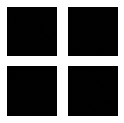

discriminator loss: 0.7453495860099792
advesarial loss: 0.6761989593505859
2/2 [==============================] - 0s 76ms/step
discriminator loss: 0.6203032732009888
advesarial loss: 0.9169993996620178


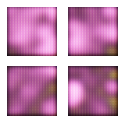

2/2 [==============================] - 0s 80ms/step
discriminator loss: 0.6855908632278442
advesarial loss: 1.4355709552764893


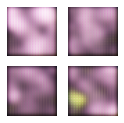

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6753295063972473
advesarial loss: 0.6243994235992432


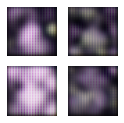

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.5874850749969482
advesarial loss: 0.7993621826171875


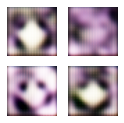

2/2 [==============================] - 0s 82ms/step


discriminator loss: 1.007576823234558
advesarial loss: 0.47550636529922485


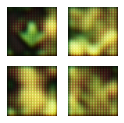

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.607675313949585
advesarial loss: 1.6039214134216309


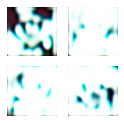

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.5493886470794678
advesarial loss: 1.4025708436965942


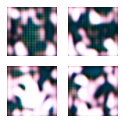

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.32442373037338257
advesarial loss: 2.4403436183929443


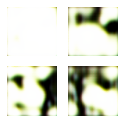

2/2 [==============================] - 0s 75ms/step


discriminator loss: 0.34974685311317444
advesarial loss: 2.46914005279541


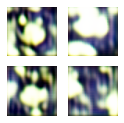

2/2 [==============================] - 0s 76ms/step


discriminator loss: 0.4639119505882263
advesarial loss: 1.462361454963684


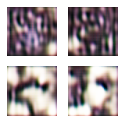

discriminator loss: 0.4639119505882263
advesarial loss: 1.462361454963684
2/2 [==============================] - 0s 77ms/step


discriminator loss: 0.5877587795257568
advesarial loss: 0.8426663875579834


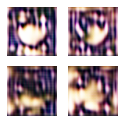

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.432442843914032
advesarial loss: 5.382063865661621


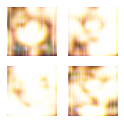

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.5851576328277588
advesarial loss: 1.1604512929916382


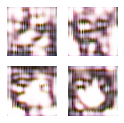

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.7465800046920776
advesarial loss: 0.6253526210784912


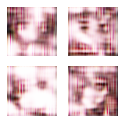

2/2 [==============================] - 0s 77ms/step


discriminator loss: 0.5011643767356873
advesarial loss: 0.5654931664466858


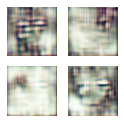

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.8312426209449768
advesarial loss: 3.0056374073028564


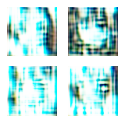

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.5543596148490906
advesarial loss: 3.7446985244750977


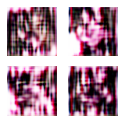

2/2 [==============================] - 0s 87ms/step
discriminator loss: 0.7955400347709656
advesarial loss: 1.241819143295288


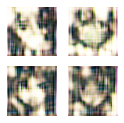

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.8790872097015381
advesarial loss: 1.02663254737854


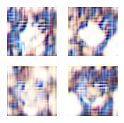

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7519476413726807
advesarial loss: 1.803067684173584


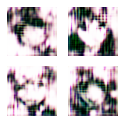

discriminator loss: 0.7519476413726807
advesarial loss: 1.803067684173584
2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6310598254203796
advesarial loss: 1.3439977169036865


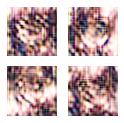

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.556413471698761
advesarial loss: 2.088972330093384


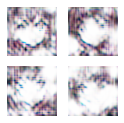

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.6029908657073975
advesarial loss: 0.9505379796028137


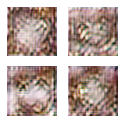

2/2 [==============================] - 0s 81ms/step


discriminator loss: 1.1180024147033691
advesarial loss: 1.5591291189193726


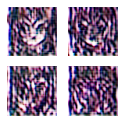

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.5820755958557129
advesarial loss: 1.0050805807113647


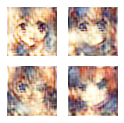

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6085456013679504
advesarial loss: 5.628727436065674


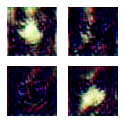

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.5381696224212646
advesarial loss: 1.4576702117919922


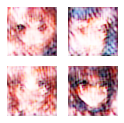

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6746609807014465
advesarial loss: 0.5682666897773743


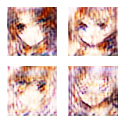

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6897123456001282
advesarial loss: 1.9710924625396729


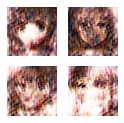

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6274914741516113
advesarial loss: 1.214674711227417


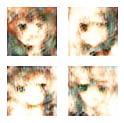

discriminator loss: 0.6274914741516113
advesarial loss: 1.214674711227417
2/2 [==============================] - 0s 83ms/step
discriminator loss: 0.8978605270385742
advesarial loss: 1.0093275308609009


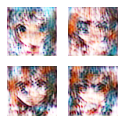

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.5788447856903076
advesarial loss: 1.3472718000411987


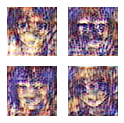

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.7256596684455872
advesarial loss: 8.5855073928833


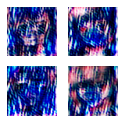

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6867746710777283
advesarial loss: 1.4434497356414795


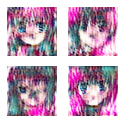

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6295930743217468
advesarial loss: 1.198819875717163


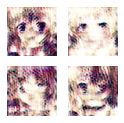

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.7375375628471375
advesarial loss: 1.7093385457992554


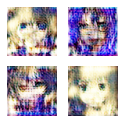

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6562344431877136
advesarial loss: 1.2243590354919434


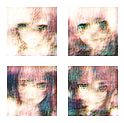

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6635884046554565
advesarial loss: 0.8005772829055786


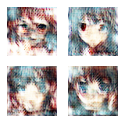

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.679149329662323
advesarial loss: 1.05192232131958


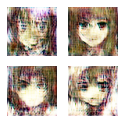

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6703156232833862
advesarial loss: 0.9749513268470764


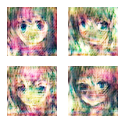

discriminator loss: 0.6703156232833862
advesarial loss: 0.9749513268470764
2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6420683264732361
advesarial loss: 1.0718296766281128


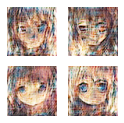

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.741904079914093
advesarial loss: 1.2608184814453125


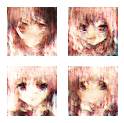

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.7181397080421448
advesarial loss: 0.5204651355743408


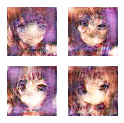

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6196455359458923
advesarial loss: 1.4936814308166504


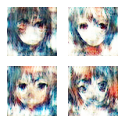

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7413153648376465
advesarial loss: 1.3371015787124634


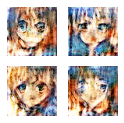

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.660391092300415
advesarial loss: 0.795265793800354


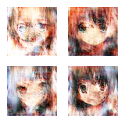

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7749693393707275
advesarial loss: 0.7755298018455505


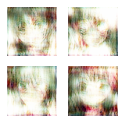

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6794816255569458
advesarial loss: 0.9096978306770325


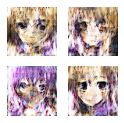

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.665539026260376
advesarial loss: 0.8832595348358154


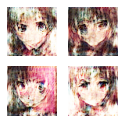

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.716564416885376
advesarial loss: 1.0543043613433838


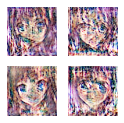

discriminator loss: 0.716564416885376
advesarial loss: 1.0543043613433838
2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7012369632720947
advesarial loss: 0.9650576114654541


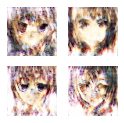

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.7078857421875
advesarial loss: 0.7908044457435608


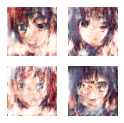

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6650577187538147
advesarial loss: 0.8479885458946228


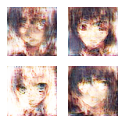

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6670533418655396
advesarial loss: 1.035048007965088


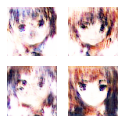

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.7060861587524414
advesarial loss: 0.8434829711914062


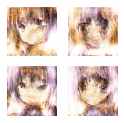

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.666442334651947
advesarial loss: 0.9097987413406372


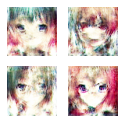

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6827085018157959
advesarial loss: 0.7657411694526672


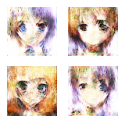

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.8455694913864136
advesarial loss: 0.8335283398628235


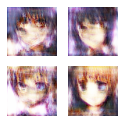

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6697342991828918
advesarial loss: 0.8486276865005493


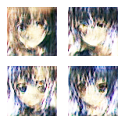

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6868784427642822
advesarial loss: 0.9885104298591614


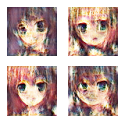

discriminator loss: 0.6868784427642822
advesarial loss: 0.9885104298591614
2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6669638156890869
advesarial loss: 0.7792664170265198


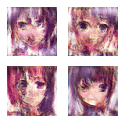

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6879560947418213
advesarial loss: 0.8258810639381409


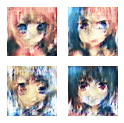

2/2 [==============================] - 0s 77ms/step


discriminator loss: 0.7164888978004456
advesarial loss: 0.9751864671707153


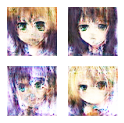

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6656838655471802
advesarial loss: 0.7910299897193909


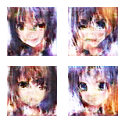

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6884825229644775
advesarial loss: 0.8872056603431702


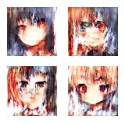

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6976066827774048
advesarial loss: 0.7773722410202026


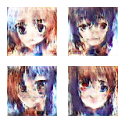

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7007694840431213
advesarial loss: 0.8924293518066406


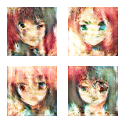

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.709937334060669
advesarial loss: 0.991601288318634


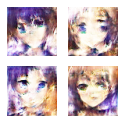

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7282582521438599
advesarial loss: 0.8825151324272156


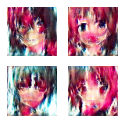

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.723796546459198
advesarial loss: 1.1213746070861816


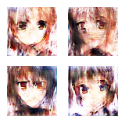

discriminator loss: 0.723796546459198
advesarial loss: 1.1213746070861816
2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6975916028022766
advesarial loss: 0.9515912532806396


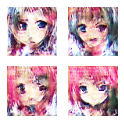

2/2 [==============================] - 0s 81ms/step
discriminator loss: 0.7069944739341736
advesarial loss: 0.8209800720214844


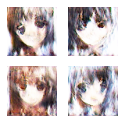

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6818095445632935
advesarial loss: 0.7691219449043274


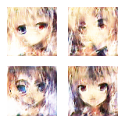

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6939002275466919
advesarial loss: 0.9122139811515808


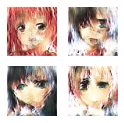

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6911960244178772
advesarial loss: 0.8587854504585266


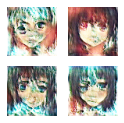

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.69936603307724
advesarial loss: 0.6486218571662903


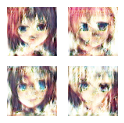

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6866376399993896
advesarial loss: 0.9518622159957886


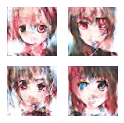

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6696381568908691
advesarial loss: 0.7558220028877258


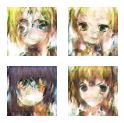

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.7152003049850464
advesarial loss: 1.0729578733444214


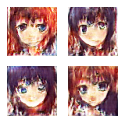

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6783428192138672
advesarial loss: 0.7057494521141052


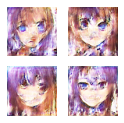

discriminator loss: 0.6783428192138672
advesarial loss: 0.7057494521141052
2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6803096532821655
advesarial loss: 0.6712378263473511


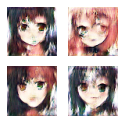

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7088788151741028
advesarial loss: 0.861501157283783


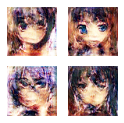

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6941750645637512
advesarial loss: 0.8771579265594482


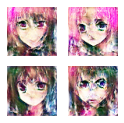

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6881585717201233
advesarial loss: 0.9999766945838928


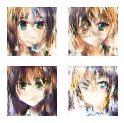

2/2 [==============================] - 0s 82ms/step
discriminator loss: 0.7054900527000427
advesarial loss: 0.8432721495628357


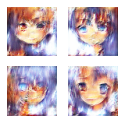

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6680653691291809
advesarial loss: 0.7029455900192261


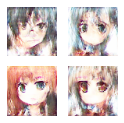

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.7007976174354553
advesarial loss: 0.9642770290374756


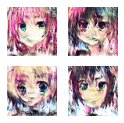

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.7176104784011841
advesarial loss: 1.1879847049713135


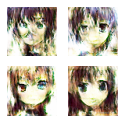

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6809636950492859
advesarial loss: 0.8521235585212708


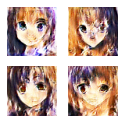

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.674429178237915
advesarial loss: 0.8624995946884155


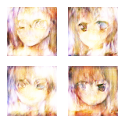

discriminator loss: 0.674429178237915
advesarial loss: 0.8624995946884155
2/2 [==============================] - 0s 77ms/step


discriminator loss: 0.879866361618042
advesarial loss: 0.9577500820159912


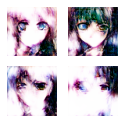

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6694177389144897
advesarial loss: 0.8354727029800415


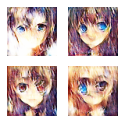

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6528012752532959
advesarial loss: 0.7298513054847717


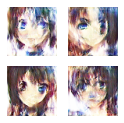

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6814100742340088
advesarial loss: 0.9318459033966064


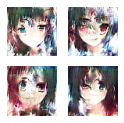

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.6832001209259033
advesarial loss: 0.6683419346809387


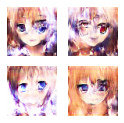

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6963903307914734
advesarial loss: 0.8493577241897583


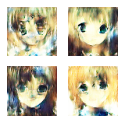

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7159029245376587
advesarial loss: 1.1035467386245728


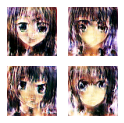

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.705451250076294
advesarial loss: 0.7058741450309753


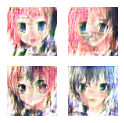

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6887151002883911
advesarial loss: 0.6226421594619751


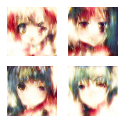

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6716209650039673
advesarial loss: 0.8716511130332947


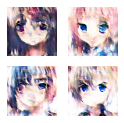

discriminator loss: 0.6716209650039673
advesarial loss: 0.8716511130332947
2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6904908418655396
advesarial loss: 0.7668359279632568


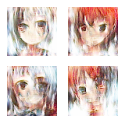

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.7005840539932251
advesarial loss: 0.7170426249504089


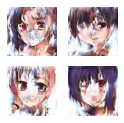

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6679126024246216
advesarial loss: 0.8733637928962708


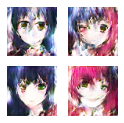

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.7610903978347778
advesarial loss: 1.0682950019836426


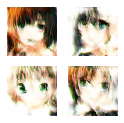

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.7075237035751343
advesarial loss: 1.0785651206970215


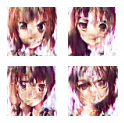

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.7298613786697388
advesarial loss: 0.7443617582321167


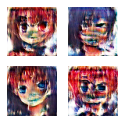

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.692854106426239
advesarial loss: 0.7694110870361328


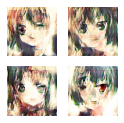

2/2 [==============================] - 0s 88ms/step


discriminator loss: 0.6990757584571838
advesarial loss: 0.6677113175392151


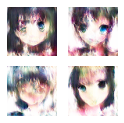

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6820470690727234
advesarial loss: 0.8231504559516907


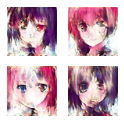

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6778309941291809
advesarial loss: 0.6737315058708191


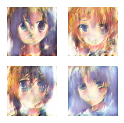

discriminator loss: 0.6778309941291809
advesarial loss: 0.6737315058708191
2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.8925189971923828
advesarial loss: 0.9674360752105713


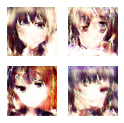

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6999626159667969
advesarial loss: 0.7944408655166626


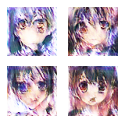

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.697304368019104
advesarial loss: 0.7894341349601746


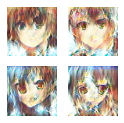

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6867562532424927
advesarial loss: 0.6914931535720825


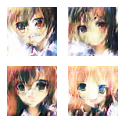

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6993836760520935
advesarial loss: 0.8310142159461975


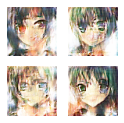

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6779214143753052
advesarial loss: 0.8150745630264282


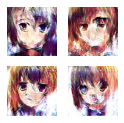

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6994903683662415
advesarial loss: 0.8046874403953552


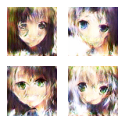

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.7036594152450562
advesarial loss: 0.6940471529960632


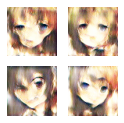

2/2 [==============================] - 0s 84ms/step


discriminator loss: 1.2414064407348633
advesarial loss: 0.6649810671806335


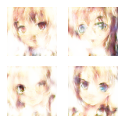

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.7007126212120056
advesarial loss: 0.7765388488769531


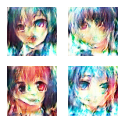

discriminator loss: 0.7007126212120056
advesarial loss: 0.7765388488769531
2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.699248194694519
advesarial loss: 0.8396263122558594


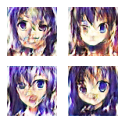

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6870930790901184
advesarial loss: 0.7936509847640991


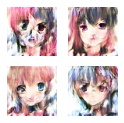

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6804327964782715
advesarial loss: 0.7955936789512634


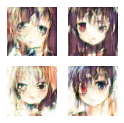

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6906152963638306
advesarial loss: 0.7056689858436584


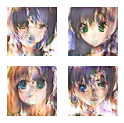

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6998316049575806
advesarial loss: 1.1820576190948486


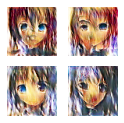

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6567704677581787
advesarial loss: 0.8177810907363892


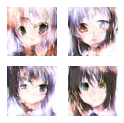

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.699137806892395
advesarial loss: 1.03658127784729


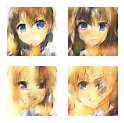

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6900570392608643
advesarial loss: 0.856774628162384


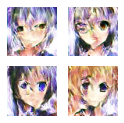

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.7132651805877686
advesarial loss: 0.8637662529945374


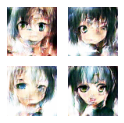

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7007011771202087
advesarial loss: 0.62129145860672


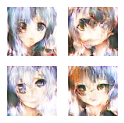

discriminator loss: 0.7007011771202087
advesarial loss: 0.62129145860672
2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6835607290267944
advesarial loss: 0.824883222579956


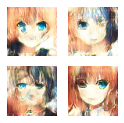

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.7029151916503906
advesarial loss: 0.7836124897003174


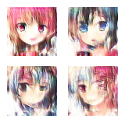

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6850666403770447
advesarial loss: 0.7721161246299744


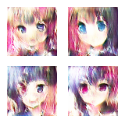

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.698261022567749
advesarial loss: 0.8228540420532227


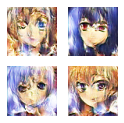

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6808633208274841
advesarial loss: 0.7482866644859314


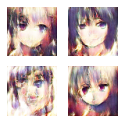

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.741169810295105
advesarial loss: 0.8173499703407288


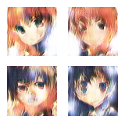

2/2 [==============================] - 0s 77ms/step


discriminator loss: 0.7070412635803223
advesarial loss: 0.7410959005355835


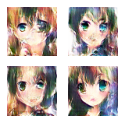

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6957745552062988
advesarial loss: 0.6902375221252441


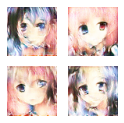

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6705019474029541
advesarial loss: 0.5917068719863892


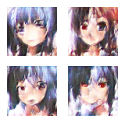

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.697640597820282
advesarial loss: 0.8321882486343384


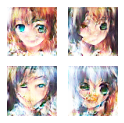

discriminator loss: 0.697640597820282
advesarial loss: 0.8321882486343384
2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7053860425949097
advesarial loss: 0.7275691628456116


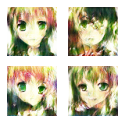

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6953746676445007
advesarial loss: 0.7060527801513672


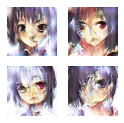

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6745384931564331
advesarial loss: 0.8009855151176453


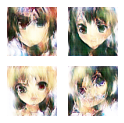

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.686201274394989
advesarial loss: 0.7881748676300049


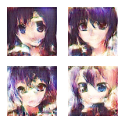

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6797105669975281
advesarial loss: 0.7860103249549866


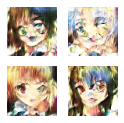

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6904120445251465
advesarial loss: 0.8124048113822937


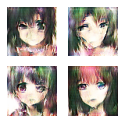

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.6795586347579956
advesarial loss: 0.7281995415687561


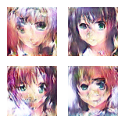

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.7125427722930908
advesarial loss: 0.8309462070465088


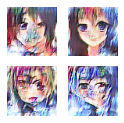

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.689671516418457
advesarial loss: 0.8929473161697388


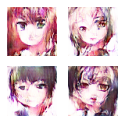

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6860362887382507
advesarial loss: 0.8415986895561218


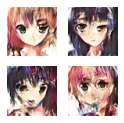

discriminator loss: 0.6860362887382507
advesarial loss: 0.8415986895561218
2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6975111365318298
advesarial loss: 0.9292373657226562


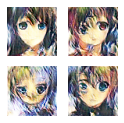

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.690880537033081
advesarial loss: 0.8815995454788208


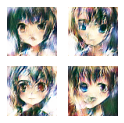

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.7051249146461487
advesarial loss: 1.0028502941131592


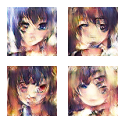

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6723402142524719
advesarial loss: 0.8523614406585693


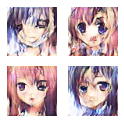

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6839683055877686
advesarial loss: 0.6843879222869873


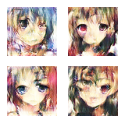

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.7372179627418518
advesarial loss: 0.9609941840171814


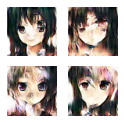

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.7156994342803955
advesarial loss: 0.7048929929733276


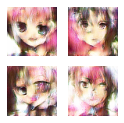

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6811879277229309
advesarial loss: 0.7822126746177673


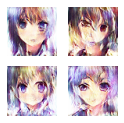

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6979929804801941
advesarial loss: 0.9709210991859436


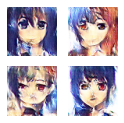

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6904181838035583
advesarial loss: 0.8062799572944641


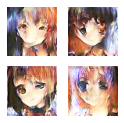

discriminator loss: 0.6904181838035583
advesarial loss: 0.8062799572944641
2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6905856728553772
advesarial loss: 0.7618595361709595


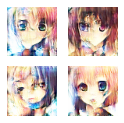

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.7192667126655579
advesarial loss: 0.8455261588096619


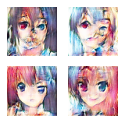

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6964525580406189
advesarial loss: 0.7665044069290161


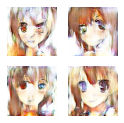

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.7062131762504578
advesarial loss: 0.7694848775863647


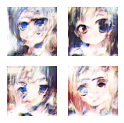

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7124836444854736
advesarial loss: 1.0532207489013672


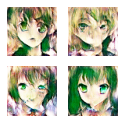

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6907942295074463
advesarial loss: 0.7715351581573486


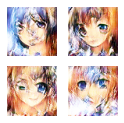

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6999155879020691
advesarial loss: 0.7270911931991577


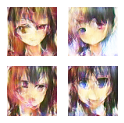

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6798660159111023
advesarial loss: 0.737625777721405


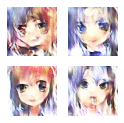

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6938414573669434
advesarial loss: 0.8280407190322876


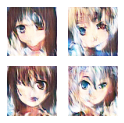

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6876029968261719
advesarial loss: 0.8404502868652344


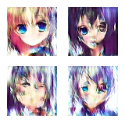

discriminator loss: 0.6876029968261719
advesarial loss: 0.8404502868652344
2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.690497100353241
advesarial loss: 0.722428560256958


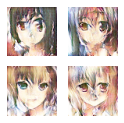

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6866331100463867
advesarial loss: 0.8354940414428711


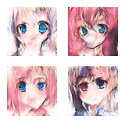

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.6955369114875793
advesarial loss: 0.8272060751914978


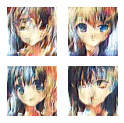

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.6833841800689697
advesarial loss: 0.742100179195404


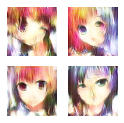

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6914961338043213
advesarial loss: 0.8511755466461182


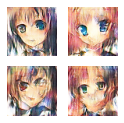

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.7416137456893921
advesarial loss: 0.9495813846588135


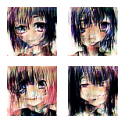

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.682094395160675
advesarial loss: 0.8510940074920654


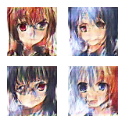

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6849915385246277
advesarial loss: 0.7772983908653259


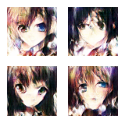

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6941034197807312
advesarial loss: 0.7939540147781372


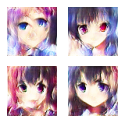

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.6770119667053223
advesarial loss: 0.787093460559845


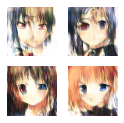

discriminator loss: 0.6770119667053223
advesarial loss: 0.787093460559845
2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.7310454845428467
advesarial loss: 1.0815988779067993


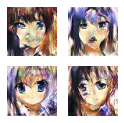

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6949204206466675
advesarial loss: 0.8809823393821716


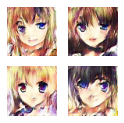

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.7247214317321777
advesarial loss: 0.8434589505195618


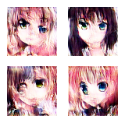

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6859903931617737
advesarial loss: 0.751613199710846


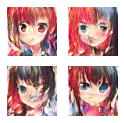

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6958906650543213
advesarial loss: 1.4044840335845947


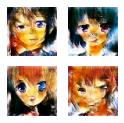

2/2 [==============================] - 0s 87ms/step


discriminator loss: 0.6953837275505066
advesarial loss: 0.7502673268318176


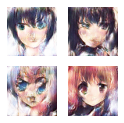

2/2 [==============================] - 0s 77ms/step


discriminator loss: 0.6921402215957642
advesarial loss: 0.8018896579742432


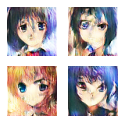

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7053211331367493
advesarial loss: 0.8304368853569031


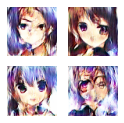

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7279373407363892
advesarial loss: 1.0273562669754028


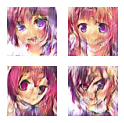

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6894319653511047
advesarial loss: 0.7296938300132751


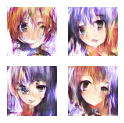

discriminator loss: 0.6894319653511047
advesarial loss: 0.7296938300132751
2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.629517138004303
advesarial loss: 0.7737785577774048


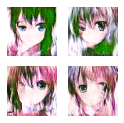

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6954081058502197
advesarial loss: 0.7898789048194885


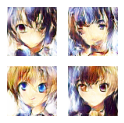

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6877487897872925
advesarial loss: 0.7429064512252808


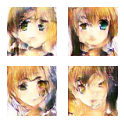

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7106136679649353
advesarial loss: 0.7728139758110046


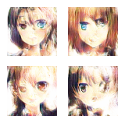

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6964307427406311
advesarial loss: 0.7336800694465637


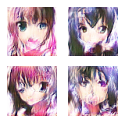

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7350149154663086
advesarial loss: 0.8167620897293091


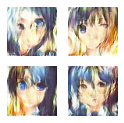

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6937212347984314
advesarial loss: 0.7740728855133057


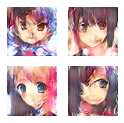

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.6953185200691223
advesarial loss: 0.8368666768074036


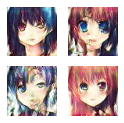

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.7033516764640808
advesarial loss: 0.917553186416626


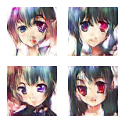

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.7021008729934692
advesarial loss: 0.8089306354522705


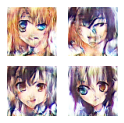

discriminator loss: 0.7021008729934692
advesarial loss: 0.8089306354522705
2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.7040638327598572
advesarial loss: 0.7712981700897217


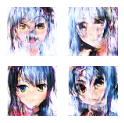

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.7182536721229553
advesarial loss: 0.8175637722015381


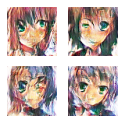

2/2 [==============================] - 0s 77ms/step


discriminator loss: 0.6917023062705994
advesarial loss: 0.8237862586975098


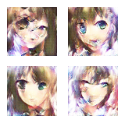

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.6730006337165833
advesarial loss: 0.9772971272468567


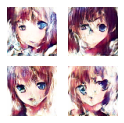

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.7080758213996887
advesarial loss: 0.8250815868377686


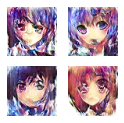

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.7003517150878906
advesarial loss: 0.7262908220291138


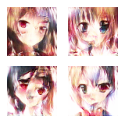

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.7275939583778381
advesarial loss: 0.6640492081642151


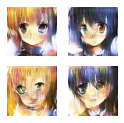

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6775944828987122
advesarial loss: 0.7374698519706726


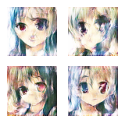

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.8034924864768982
advesarial loss: 0.802670955657959


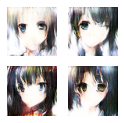

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6996995210647583
advesarial loss: 0.7390512228012085


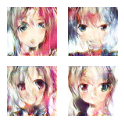

discriminator loss: 0.6996995210647583
advesarial loss: 0.7390512228012085
2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6967416405677795
advesarial loss: 0.7338917255401611


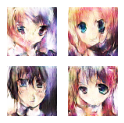

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6877295970916748
advesarial loss: 0.8656145930290222


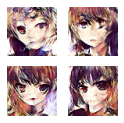

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6937973499298096
advesarial loss: 0.7161685824394226


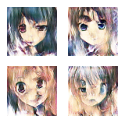

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6990743279457092
advesarial loss: 0.7089890241622925


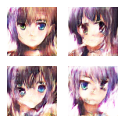

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6934511661529541
advesarial loss: 0.6966840028762817


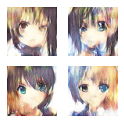

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6930444240570068
advesarial loss: 0.8089574575424194


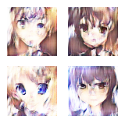

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6765236258506775
advesarial loss: 0.9818302989006042


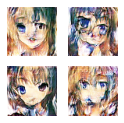

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6792452335357666
advesarial loss: 0.7242463827133179


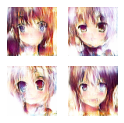

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6842158436775208
advesarial loss: 0.8627521395683289


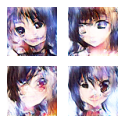

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6805400252342224
advesarial loss: 0.6973659992218018


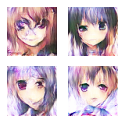

discriminator loss: 0.6805400252342224
advesarial loss: 0.6973659992218018
2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6969756484031677
advesarial loss: 0.7024041414260864


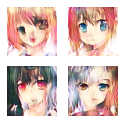

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6997974514961243
advesarial loss: 0.6596408486366272


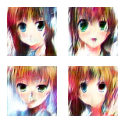

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6999067068099976
advesarial loss: 0.7946889400482178


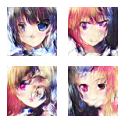

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.5056504011154175
advesarial loss: 1.2420240640640259


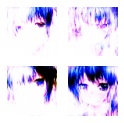

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.5398308634757996
advesarial loss: 1.0094506740570068


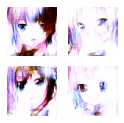

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.5525462031364441
advesarial loss: 1.9325032234191895


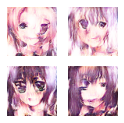

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6851478219032288
advesarial loss: 0.7474187612533569


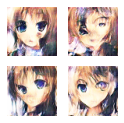

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.7157081961631775
advesarial loss: 0.5859965085983276


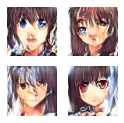

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.7084740400314331
advesarial loss: 1.0565745830535889


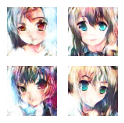

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7076554894447327
advesarial loss: 0.9460703730583191


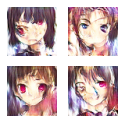

discriminator loss: 0.7076554894447327
advesarial loss: 0.9460703730583191
2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6970941424369812
advesarial loss: 0.9410474300384521


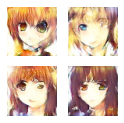

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7330049276351929
advesarial loss: 0.9811308979988098


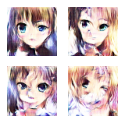

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.7046012878417969
advesarial loss: 0.8680824041366577


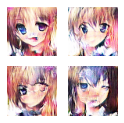

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.7079132795333862
advesarial loss: 0.8761171698570251


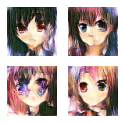

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6886063814163208
advesarial loss: 0.7625739574432373


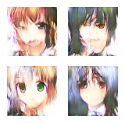

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6867715716362
advesarial loss: 0.8551061153411865


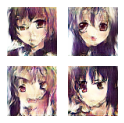

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.8279175162315369
advesarial loss: 1.1319365501403809


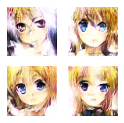

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.5586941242218018
advesarial loss: 1.0981658697128296


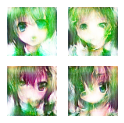

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.6857247948646545
advesarial loss: 0.8706936240196228


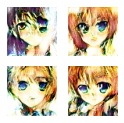

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.6802680492401123
advesarial loss: 0.7699465751647949


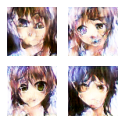

discriminator loss: 0.6802680492401123
advesarial loss: 0.7699465751647949
2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6792242527008057
advesarial loss: 0.9696524739265442


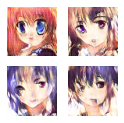

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.6713513731956482
advesarial loss: 0.6919922828674316


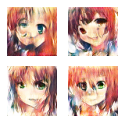

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6934177875518799
advesarial loss: 0.7624863982200623


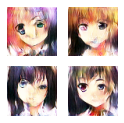

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.7235562801361084
advesarial loss: 0.6834142208099365


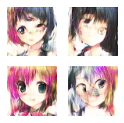

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6992321014404297
advesarial loss: 0.791719377040863


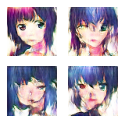

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6440138816833496
advesarial loss: 2.105440139770508


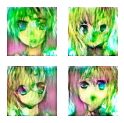

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.2629113793373108
advesarial loss: 2.9773974418640137


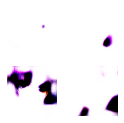

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.12045253813266754
advesarial loss: 4.733858108520508


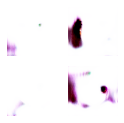

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.08356358855962753
advesarial loss: 1.9066238403320312


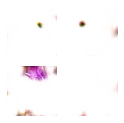

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.650768518447876
advesarial loss: 3.226332187652588


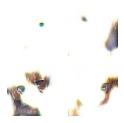

discriminator loss: 0.650768518447876
advesarial loss: 3.226332187652588
2/2 [==============================] - 0s 84ms/step


discriminator loss: 2.501444101333618
advesarial loss: 1.1497184038162231


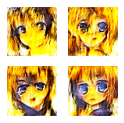

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7213819026947021
advesarial loss: 0.5709251761436462


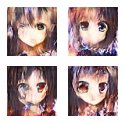

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6240271925926208
advesarial loss: 0.8998106718063354


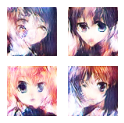

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.7031291127204895
advesarial loss: 0.6491981148719788


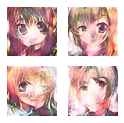

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.15471233427524567
advesarial loss: 1.0640103816986084


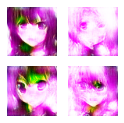

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.15588101744651794
advesarial loss: 9.791504859924316


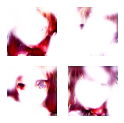

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6062412858009338
advesarial loss: 0.9550554752349854


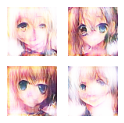

2/2 [==============================] - 0s 83ms/step
discriminator loss: 0.7180205583572388
advesarial loss: 0.6089766621589661


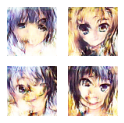

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7011198401451111
advesarial loss: 1.025578260421753


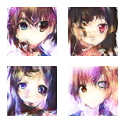

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7137851119041443
advesarial loss: 0.904769778251648


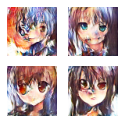

discriminator loss: 0.7137851119041443
advesarial loss: 0.904769778251648
2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6777442097663879
advesarial loss: 0.7703704833984375


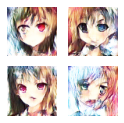

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6816586852073669
advesarial loss: 0.7057531476020813


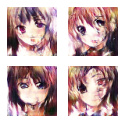

2/2 [==============================] - 0s 79ms/step


discriminator loss: 1.6089179515838623
advesarial loss: 3.1636219024658203


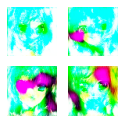

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.49081236124038696
advesarial loss: 1.6247327327728271


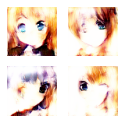

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6562727689743042
advesarial loss: 0.7436336278915405


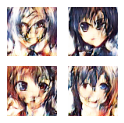

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.6718623042106628
advesarial loss: 0.7449654936790466


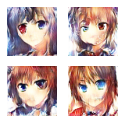

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.7852901816368103
advesarial loss: 0.7330631017684937


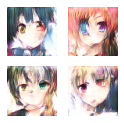

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6776162981987
advesarial loss: 0.8874682188034058


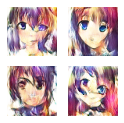

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.7792186141014099
advesarial loss: 0.8432199954986572


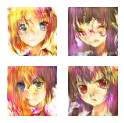

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6881886720657349
advesarial loss: 1.0898481607437134


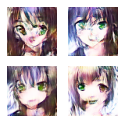

discriminator loss: 0.6881886720657349
advesarial loss: 1.0898481607437134
2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6899120807647705
advesarial loss: 0.7815266847610474


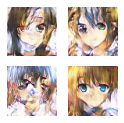

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.8511801958084106
advesarial loss: 0.7922784686088562


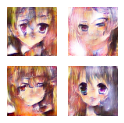

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7189273834228516
advesarial loss: 0.7876654863357544


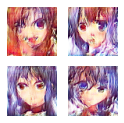

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7188639044761658
advesarial loss: 10.581905364990234


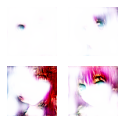

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.5650987029075623
advesarial loss: 0.9321260452270508


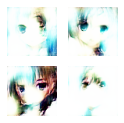

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.70424884557724
advesarial loss: 0.6736894845962524


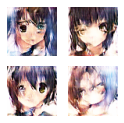

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6677902340888977
advesarial loss: 0.5335708260536194


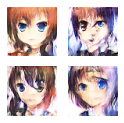

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.696986973285675
advesarial loss: 0.6154722571372986


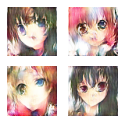

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.4661848247051239
advesarial loss: 1.9098728895187378


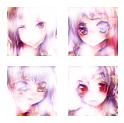

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6785820126533508
advesarial loss: 0.7957119345664978


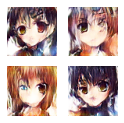

discriminator loss: 0.6785820126533508
advesarial loss: 0.7957119345664978
2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6914368867874146
advesarial loss: 0.7017121911048889


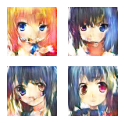

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.7440134882926941
advesarial loss: 0.671362578868866


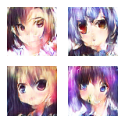

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.7282164096832275
advesarial loss: 0.7375978231430054


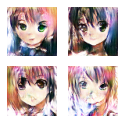

2/2 [==============================] - 0s 77ms/step


discriminator loss: 0.6787194013595581
advesarial loss: 0.9341479539871216


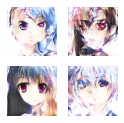

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7001277804374695
advesarial loss: 0.7825908660888672


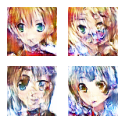

2/2 [==============================] - 0s 85ms/step


discriminator loss: 1.097132921218872
advesarial loss: 0.8606610894203186


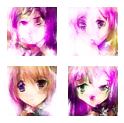

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.6622194051742554
advesarial loss: 0.8350052237510681


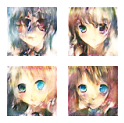

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.689395546913147
advesarial loss: 0.9016348719596863


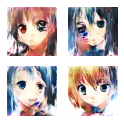

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6704035401344299
advesarial loss: 0.775456428527832


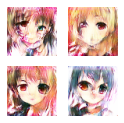

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6926867961883545
advesarial loss: 0.7776417136192322


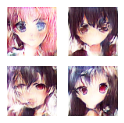

discriminator loss: 0.6926867961883545
advesarial loss: 0.7776417136192322
2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.682047426700592
advesarial loss: 0.722033679485321


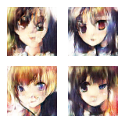

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.6813686490058899
advesarial loss: 0.9210596084594727


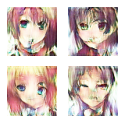

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.729360818862915
advesarial loss: 0.8915221691131592


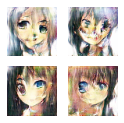

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7011061906814575
advesarial loss: 0.6808476448059082


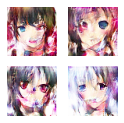

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.8443193435668945
advesarial loss: 1.0431450605392456


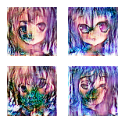

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6728622317314148
advesarial loss: 1.1635968685150146


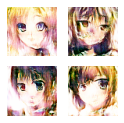

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.7308403253555298
advesarial loss: 0.43371662497520447


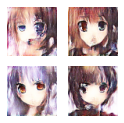

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.7228526473045349
advesarial loss: 0.8737581968307495


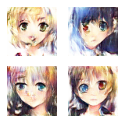

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6884440779685974
advesarial loss: 0.8740804195404053


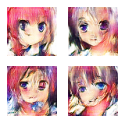

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6746861338615417
advesarial loss: 1.3171440362930298


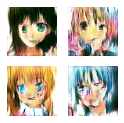

discriminator loss: 0.6746861338615417
advesarial loss: 1.3171440362930298
2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6519272327423096
advesarial loss: 0.8483412861824036


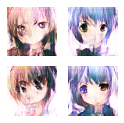

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7032396793365479
advesarial loss: 0.6527416110038757


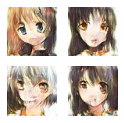

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6660770773887634
advesarial loss: 0.9091651439666748


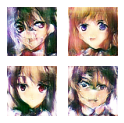

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6966829299926758
advesarial loss: 0.8274040222167969


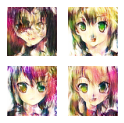

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6795632839202881
advesarial loss: 0.9838698506355286


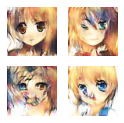

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.6521008610725403
advesarial loss: 1.1742033958435059


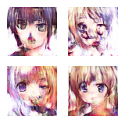

2/2 [==============================] - 0s 80ms/step


discriminator loss: 1.4385775327682495
advesarial loss: 0.4484597444534302


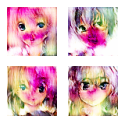

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6878738403320312
advesarial loss: 0.8840348720550537


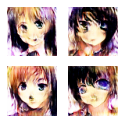

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6509233713150024
advesarial loss: 0.6732523441314697


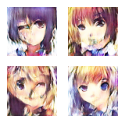

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.678339958190918
advesarial loss: 0.8353585004806519


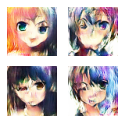

discriminator loss: 0.678339958190918
advesarial loss: 0.8353585004806519
2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7117601037025452
advesarial loss: 1.131335735321045


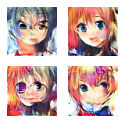

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.7060472369194031
advesarial loss: 0.9007904529571533


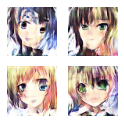

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.6990258693695068
advesarial loss: 0.7961394190788269


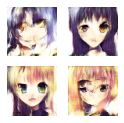

2/2 [==============================] - 0s 87ms/step


discriminator loss: 0.6866835951805115
advesarial loss: 0.6096814274787903


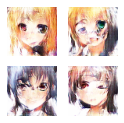

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6965625286102295
advesarial loss: 0.7181122303009033


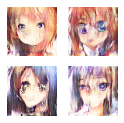

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.5604820251464844
advesarial loss: 1.296347975730896


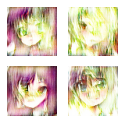

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.7271044254302979
advesarial loss: 0.8807463049888611


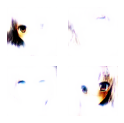

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6571404933929443
advesarial loss: 1.4028786420822144


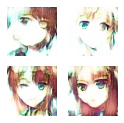

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6540610790252686
advesarial loss: 0.9345647096633911


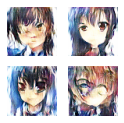

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6671499609947205
advesarial loss: 0.738122820854187


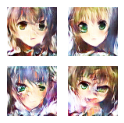

discriminator loss: 0.6671499609947205
advesarial loss: 0.738122820854187
2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7375292181968689
advesarial loss: 1.109444260597229


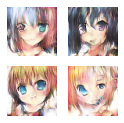

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6878638863563538
advesarial loss: 0.844452440738678


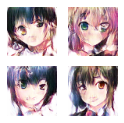

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7072499394416809
advesarial loss: 1.1757941246032715


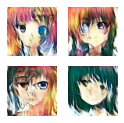

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7056572437286377
advesarial loss: 0.8957651853561401


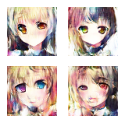

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.6929188370704651
advesarial loss: 0.8455827832221985


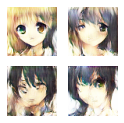

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7464125156402588
advesarial loss: 1.1728954315185547


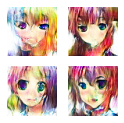

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6883666515350342
advesarial loss: 1.0192358493804932


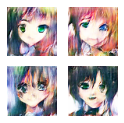

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.664514422416687
advesarial loss: 0.7871537804603577


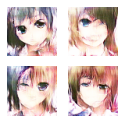

2/2 [==============================] - 0s 81ms/step


discriminator loss: 3.483302593231201
advesarial loss: 6.006297588348389


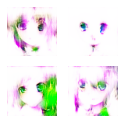

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.2536736726760864
advesarial loss: 1.4347071647644043


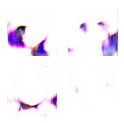

discriminator loss: 0.2536736726760864
advesarial loss: 1.4347071647644043
2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.5963703393936157
advesarial loss: 1.0069230794906616


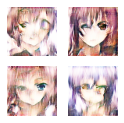

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.6433099508285522
advesarial loss: 0.9012160897254944


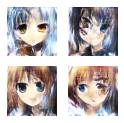

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.8250768184661865
advesarial loss: 0.548360288143158


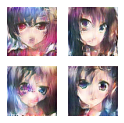

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.6693808436393738
advesarial loss: 0.6855237483978271


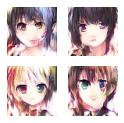

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.691051185131073
advesarial loss: 0.7773604989051819


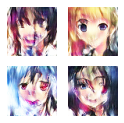

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.7001963257789612
advesarial loss: 0.7721837162971497


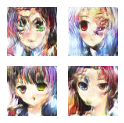

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6972094178199768
advesarial loss: 0.7851646542549133


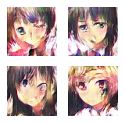

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7110004425048828
advesarial loss: 0.883697509765625


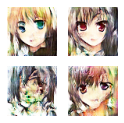

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.7021343111991882
advesarial loss: 0.5666518211364746


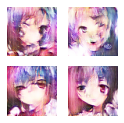

2/2 [==============================] - 0s 81ms/step


discriminator loss: 1.132388949394226
advesarial loss: 9.902145385742188


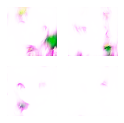

discriminator loss: 1.132388949394226
advesarial loss: 9.902145385742188
2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.4979863166809082
advesarial loss: 2.972243547439575


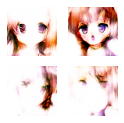

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6692283153533936
advesarial loss: 0.7722065448760986


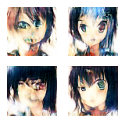

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6518157124519348
advesarial loss: 1.0488218069076538


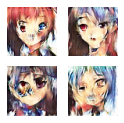

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.6738182902336121
advesarial loss: 0.8694261312484741


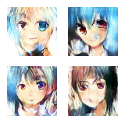

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.6581314206123352
advesarial loss: 0.9723671674728394


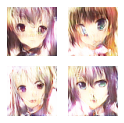

2/2 [==============================] - 0s 85ms/step


discriminator loss: 2.327796459197998
advesarial loss: 1.8003095388412476


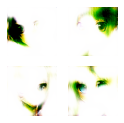

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.39240506291389465
advesarial loss: 1.9640960693359375


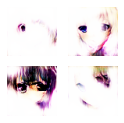

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6408776044845581
advesarial loss: 0.8619277477264404


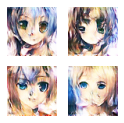

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6378397941589355
advesarial loss: 0.9037526249885559


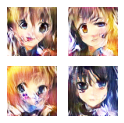

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.8551597595214844
advesarial loss: 0.38313156366348267


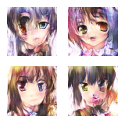

discriminator loss: 0.8551597595214844
advesarial loss: 0.38313156366348267
2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7035195231437683
advesarial loss: 0.8685299158096313


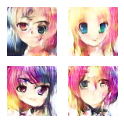

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7035232186317444
advesarial loss: 0.7026737928390503


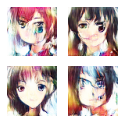

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7371970415115356
advesarial loss: 1.4423279762268066


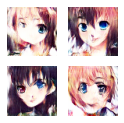

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7923604846000671
advesarial loss: 1.0228056907653809


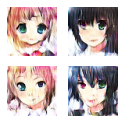

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.716180145740509
advesarial loss: 1.3066309690475464


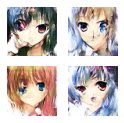

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.7050297856330872
advesarial loss: 1.0549567937850952


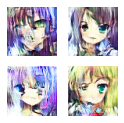

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6371158957481384
advesarial loss: 1.7285687923431396


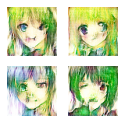

2/2 [==============================] - 0s 82ms/step


discriminator loss: 1.4974231719970703
advesarial loss: 0.38577020168304443


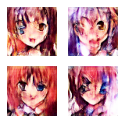

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6349090337753296
advesarial loss: 0.7725369930267334


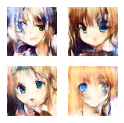

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6708044409751892
advesarial loss: 0.8780351877212524


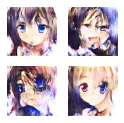

discriminator loss: 0.6708044409751892
advesarial loss: 0.8780351877212524
2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.7783015966415405
advesarial loss: 1.1379531621932983


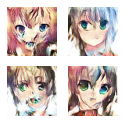

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.764924168586731
advesarial loss: 0.6691133379936218


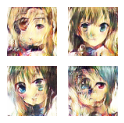

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.7095363140106201
advesarial loss: 1.0545073747634888


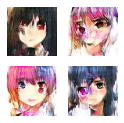

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.7516915202140808
advesarial loss: 1.1549253463745117


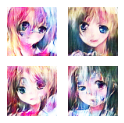

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7031474113464355
advesarial loss: 0.5433437824249268


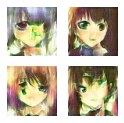

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6979557871818542
advesarial loss: 1.02253258228302


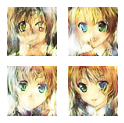

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.733818531036377
advesarial loss: 1.209973931312561


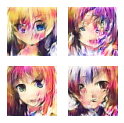

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7203387022018433
advesarial loss: 0.6627613306045532


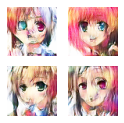

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.6690952181816101
advesarial loss: 0.6654891967773438


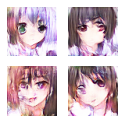

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.7106868624687195
advesarial loss: 1.033429503440857


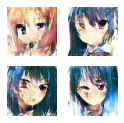

discriminator loss: 0.7106868624687195
advesarial loss: 1.033429503440857
2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.684721052646637
advesarial loss: 0.9120360612869263


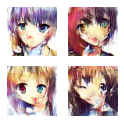

2/2 [==============================] - 0s 84ms/step


discriminator loss: 1.2159762382507324
advesarial loss: 0.7562283873558044


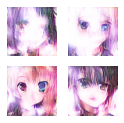

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6536076068878174
advesarial loss: 0.8886523246765137


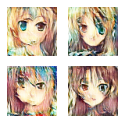

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.6227161288261414
advesarial loss: 0.8128527402877808


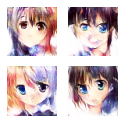

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.6866836547851562
advesarial loss: 0.6458656787872314


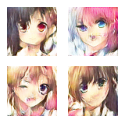

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6486330032348633
advesarial loss: 0.9289354681968689


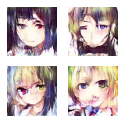

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7338860034942627
advesarial loss: 1.1198809146881104


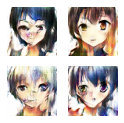

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6741254329681396
advesarial loss: 0.9122440814971924


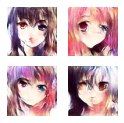

2/2 [==============================] - 0s 81ms/step
discriminator loss: 0.7101643085479736
advesarial loss: 0.733478307723999


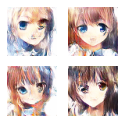

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7310113906860352
advesarial loss: 1.0570788383483887


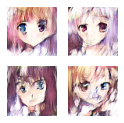

discriminator loss: 0.7310113906860352
advesarial loss: 1.0570788383483887
2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.715752363204956
advesarial loss: 0.7923204302787781


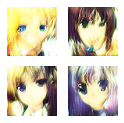

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.721199095249176
advesarial loss: 0.8462920188903809


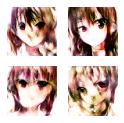

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.6299492716789246
advesarial loss: 1.0635689496994019


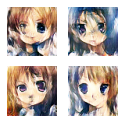

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6741085648536682
advesarial loss: 0.717858076095581


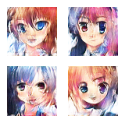

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6700561046600342
advesarial loss: 0.7473873496055603


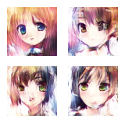

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.679916501045227
advesarial loss: 0.7760927677154541


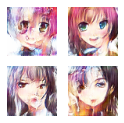

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6781076192855835
advesarial loss: 0.7320942878723145


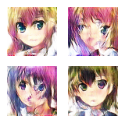

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.6736290454864502
advesarial loss: 1.0732601881027222


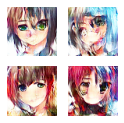

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.7102053761482239
advesarial loss: 0.9244736433029175


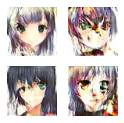

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.678307056427002
advesarial loss: 0.8167545795440674


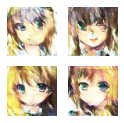

discriminator loss: 0.678307056427002
advesarial loss: 0.8167545795440674
2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6719583868980408
advesarial loss: 0.9174641370773315


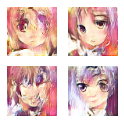

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.694960355758667
advesarial loss: 0.9257810115814209


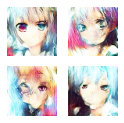

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6684530377388
advesarial loss: 0.9018822908401489


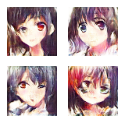

2/2 [==============================] - 0s 88ms/step


discriminator loss: 0.6218091249465942
advesarial loss: 4.610235691070557


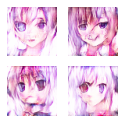

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.657600998878479
advesarial loss: 0.8332181572914124


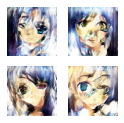

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6742391586303711
advesarial loss: 0.6738593578338623


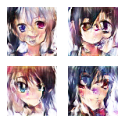

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6597091555595398
advesarial loss: 0.7817630767822266


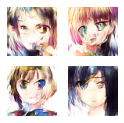

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6859033107757568
advesarial loss: 0.759917140007019


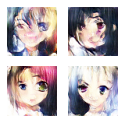

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7184041142463684
advesarial loss: 0.8998124599456787


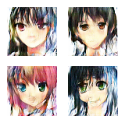

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.7039815783500671
advesarial loss: 1.091845989227295


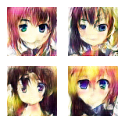

discriminator loss: 0.7039815783500671
advesarial loss: 1.091845989227295
2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.637266218662262
advesarial loss: 2.2997405529022217


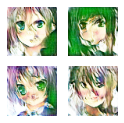

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.5950432419776917
advesarial loss: 0.9834819436073303


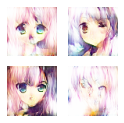

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6951989531517029
advesarial loss: 0.6760264039039612


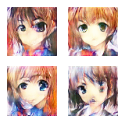

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.7509206533432007
advesarial loss: 1.059570074081421


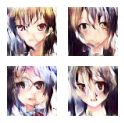

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.6643957495689392
advesarial loss: 1.0059418678283691


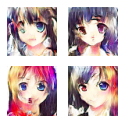

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7744638323783875
advesarial loss: 1.2008435726165771


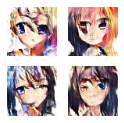

2/2 [==============================] - 0s 88ms/step


discriminator loss: 0.6822037100791931
advesarial loss: 1.0885531902313232


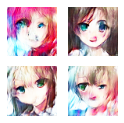

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6533203721046448
advesarial loss: 1.2665600776672363


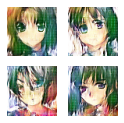

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7325509786605835
advesarial loss: 0.7196761965751648


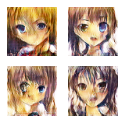

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6789928674697876
advesarial loss: 0.8941153287887573


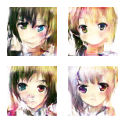

discriminator loss: 0.6789928674697876
advesarial loss: 0.8941153287887573
2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6833808422088623
advesarial loss: 0.7840805649757385


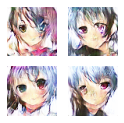

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.76439368724823
advesarial loss: 1.0963083505630493


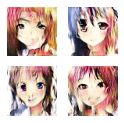

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6577112674713135
advesarial loss: 0.6312597990036011


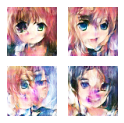

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.7075015902519226
advesarial loss: 0.7595889568328857


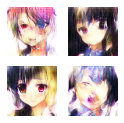

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.4515342712402344
advesarial loss: 3.3720614910125732


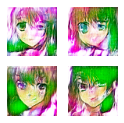

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.7209096550941467
advesarial loss: 0.953845739364624


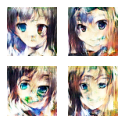

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6514263153076172
advesarial loss: 0.8007385730743408


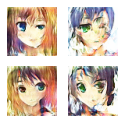

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7327337265014648
advesarial loss: 0.7661638259887695


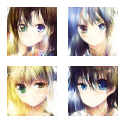

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7614548206329346
advesarial loss: 0.9396197199821472


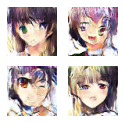

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7036980390548706
advesarial loss: 0.9123973846435547


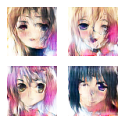

discriminator loss: 0.7036980390548706
advesarial loss: 0.9123973846435547
2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6930583715438843
advesarial loss: 0.9782751798629761


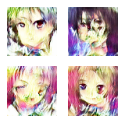

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.712321400642395
advesarial loss: 1.1730637550354004


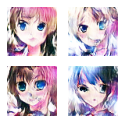

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.7094991207122803
advesarial loss: 0.7722568511962891


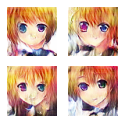

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6900384426116943
advesarial loss: 0.8977172374725342


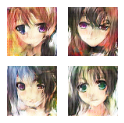

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.6492783427238464
advesarial loss: 0.9319503307342529


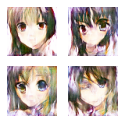

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6346556544303894
advesarial loss: 0.910608172416687


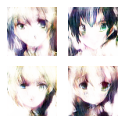

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.5625641942024231
advesarial loss: 1.36319899559021


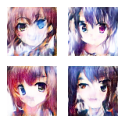

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.661799430847168
advesarial loss: 0.7932296991348267


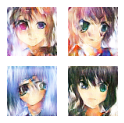

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6624720096588135
advesarial loss: 0.7198368906974792


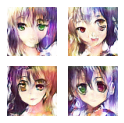

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.7014868259429932
advesarial loss: 1.144126534461975


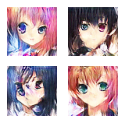

discriminator loss: 0.7014868259429932
advesarial loss: 1.144126534461975
2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.6995246410369873
advesarial loss: 0.694733202457428


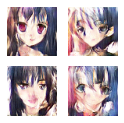

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.7078909873962402
advesarial loss: 1.0600605010986328


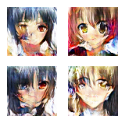

2/2 [==============================] - 0s 87ms/step


discriminator loss: 0.7099141478538513
advesarial loss: 1.1960906982421875


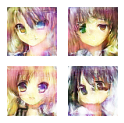

2/2 [==============================] - 0s 81ms/step
discriminator loss: 0.6862916350364685
advesarial loss: 0.7791539430618286


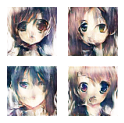

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6630095839500427
advesarial loss: 0.6631057262420654


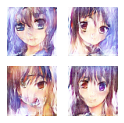

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6700142621994019
advesarial loss: 0.9006982445716858


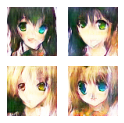

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.6637112498283386
advesarial loss: 0.7950367331504822


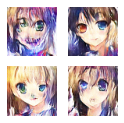

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6738096475601196
advesarial loss: 1.062628984451294


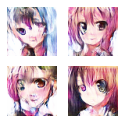

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7257059216499329
advesarial loss: 1.011792540550232


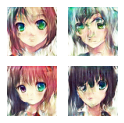

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6859360337257385
advesarial loss: 0.7651413083076477


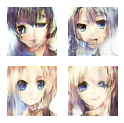

discriminator loss: 0.6859360337257385
advesarial loss: 0.7651413083076477
2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6753625869750977
advesarial loss: 0.9951726198196411


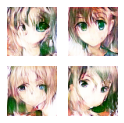

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6863231062889099
advesarial loss: 0.7516965866088867


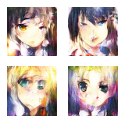

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.7504324316978455
advesarial loss: 1.2915804386138916


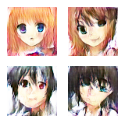

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6771944165229797
advesarial loss: 0.9879624247550964


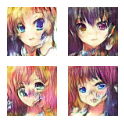

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6819959282875061
advesarial loss: 0.7957643866539001


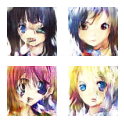

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.7141996622085571
advesarial loss: 1.054213047027588


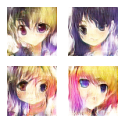

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6761000156402588
advesarial loss: 1.2435771226882935


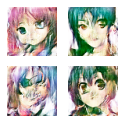

2/2 [==============================] - 0s 77ms/step


discriminator loss: 0.6571547389030457
advesarial loss: 0.7578490972518921


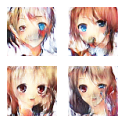

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6662997007369995
advesarial loss: 0.8173856139183044


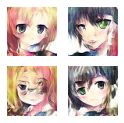

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.6940100193023682
advesarial loss: 0.7234389185905457


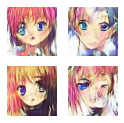

discriminator loss: 0.6940100193023682
advesarial loss: 0.7234389185905457
2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6493213176727295
advesarial loss: 0.7275882959365845


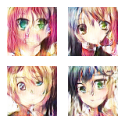

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6832128763198853
advesarial loss: 0.8400307297706604


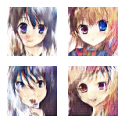

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.5992568135261536
advesarial loss: 1.0175210237503052


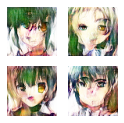

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.5967090725898743
advesarial loss: 0.513695240020752


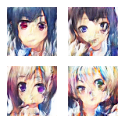

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.7121403813362122
advesarial loss: 0.7821424007415771


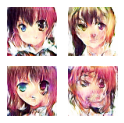

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.7242190837860107
advesarial loss: 0.746670663356781


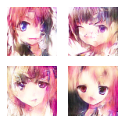

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7173585891723633
advesarial loss: 0.5541665554046631


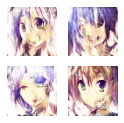

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6745954155921936
advesarial loss: 0.7443760633468628


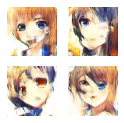

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6983036994934082
advesarial loss: 0.7201010584831238


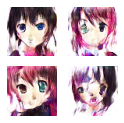

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.7780048847198486
advesarial loss: 0.8375180959701538


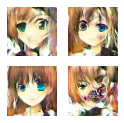

discriminator loss: 0.7780048847198486
advesarial loss: 0.8375180959701538
2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.6858193874359131
advesarial loss: 0.7541170120239258


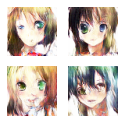

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6944128274917603
advesarial loss: 0.7695674300193787


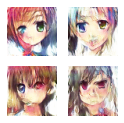

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.7745738625526428
advesarial loss: 0.689741849899292


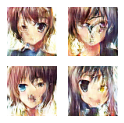

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6744221448898315
advesarial loss: 0.6566855907440186


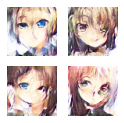

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6993968486785889
advesarial loss: 0.984816312789917


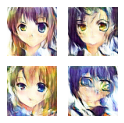

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.7592632174491882
advesarial loss: 1.1523430347442627


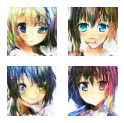

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.7116648554801941
advesarial loss: 1.0013102293014526


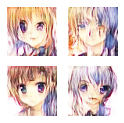

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6888017058372498
advesarial loss: 0.6256556510925293


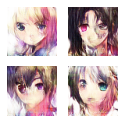

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6960574388504028
advesarial loss: 0.7061519622802734


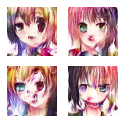

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7474038600921631
advesarial loss: 0.9960136413574219


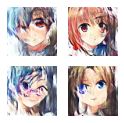

discriminator loss: 0.7474038600921631
advesarial loss: 0.9960136413574219
2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6897180676460266
advesarial loss: 1.0485457181930542


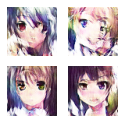

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7040783166885376
advesarial loss: 0.922033965587616


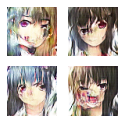

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.737947940826416
advesarial loss: 1.1931935548782349


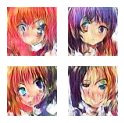

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.6705970764160156
advesarial loss: 0.9526544213294983


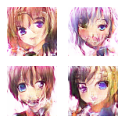

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6949598789215088
advesarial loss: 0.7859810590744019


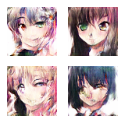

2/2 [==============================] - 0s 82ms/step


discriminator loss: 1.9319987297058105
advesarial loss: 0.7100421786308289


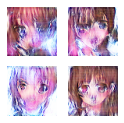

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6377290487289429
advesarial loss: 0.9074480533599854


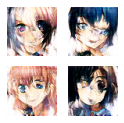

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6478058099746704
advesarial loss: 0.8492603302001953


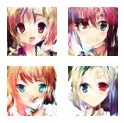

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6525696516036987
advesarial loss: 0.8579341173171997


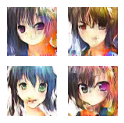

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6997973918914795
advesarial loss: 0.8886974453926086


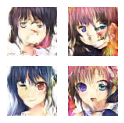

discriminator loss: 0.6997973918914795
advesarial loss: 0.8886974453926086
2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6808708310127258
advesarial loss: 0.8342325687408447


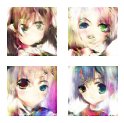

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6804205775260925
advesarial loss: 0.7625857591629028


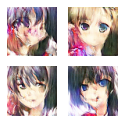

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6213603615760803
advesarial loss: 0.7039515376091003


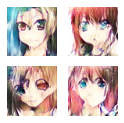

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6937048435211182
advesarial loss: 0.9535082578659058


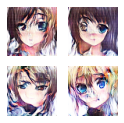

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.7389324307441711
advesarial loss: 0.7210493683815002


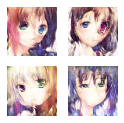

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6814599633216858
advesarial loss: 0.935271680355072


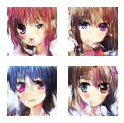

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.674139678478241
advesarial loss: 0.7976844906806946


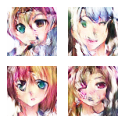

2/2 [==============================] - 0s 83ms/step
discriminator loss: 0.6976382732391357
advesarial loss: 0.650155782699585


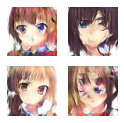

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6534323692321777
advesarial loss: 1.021020531654358


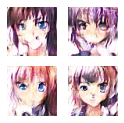

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.7081714272499084
advesarial loss: 0.9060729146003723


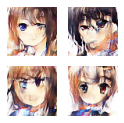

discriminator loss: 0.7081714272499084
advesarial loss: 0.9060729146003723
2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.701322078704834
advesarial loss: 0.6845393776893616


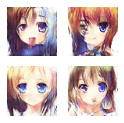

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.685309648513794
advesarial loss: 1.0736355781555176


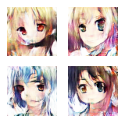

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.7051304578781128
advesarial loss: 0.9450964331626892


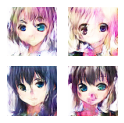

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.738353431224823
advesarial loss: 0.5641202330589294


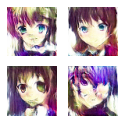

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.721619188785553
advesarial loss: 0.8689904808998108


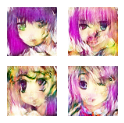

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.7152685523033142
advesarial loss: 0.8717045783996582


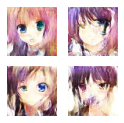

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.651025652885437
advesarial loss: 0.8406305909156799


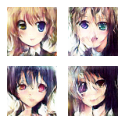

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.7383835911750793
advesarial loss: 0.923712432384491


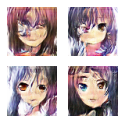

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.6814479231834412
advesarial loss: 0.8686438798904419


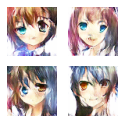

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7347559928894043
advesarial loss: 1.057397484779358


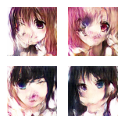

discriminator loss: 0.7347559928894043
advesarial loss: 1.057397484779358
2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6875864267349243
advesarial loss: 0.8143768310546875


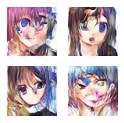

2/2 [==============================] - 0s 87ms/step


discriminator loss: 0.6544394493103027
advesarial loss: 0.8056352734565735


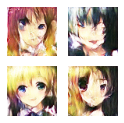

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6601370573043823
advesarial loss: 0.9407546520233154


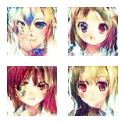

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7179246544837952
advesarial loss: 0.7593967914581299


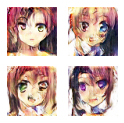

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.714482843875885
advesarial loss: 1.1835920810699463


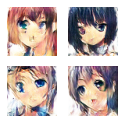

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6111805438995361
advesarial loss: 1.2324583530426025


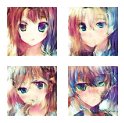

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6880258917808533
advesarial loss: 0.8795160055160522


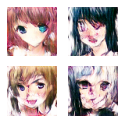

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.7778622508049011
advesarial loss: 0.6904062628746033


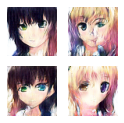

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.7134177684783936
advesarial loss: 0.7156298756599426


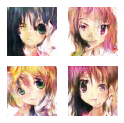

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7316378355026245
advesarial loss: 1.0692428350448608


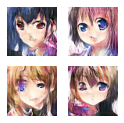

discriminator loss: 0.7316378355026245
advesarial loss: 1.0692428350448608
2/2 [==============================] - 0s 77ms/step


discriminator loss: 0.6647461652755737
advesarial loss: 1.0671743154525757


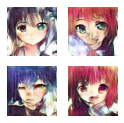

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6886404752731323
advesarial loss: 0.9287773966789246


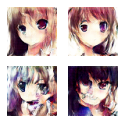

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.7208590507507324
advesarial loss: 3.270150899887085


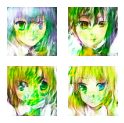

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.6974310874938965
advesarial loss: 0.7606402039527893


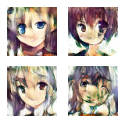

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6771872043609619
advesarial loss: 0.8318213224411011


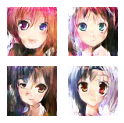

2/2 [==============================] - 0s 76ms/step


discriminator loss: 0.6773321032524109
advesarial loss: 1.0093408823013306


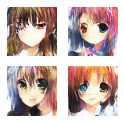

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6718867421150208
advesarial loss: 0.8927631378173828


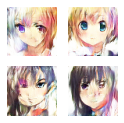

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.6689769625663757
advesarial loss: 0.8394548892974854


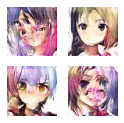

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.697971761226654
advesarial loss: 1.0428690910339355


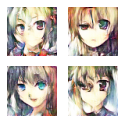

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.7909877300262451
advesarial loss: 2.115297555923462


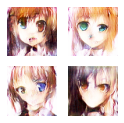

discriminator loss: 0.7909877300262451
advesarial loss: 2.115297555923462
2/2 [==============================] - 0s 77ms/step


discriminator loss: 0.6910842061042786
advesarial loss: 0.819525957107544


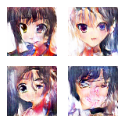

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.7100537419319153
advesarial loss: 0.965190052986145


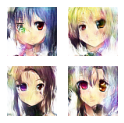

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6862823963165283
advesarial loss: 0.9356607794761658


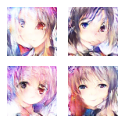

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6613942980766296
advesarial loss: 1.4386852979660034


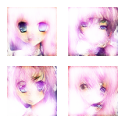

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.6662088632583618
advesarial loss: 0.9946825504302979


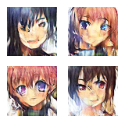

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7307539582252502
advesarial loss: 0.649823784828186


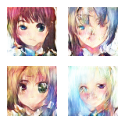

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6688162088394165
advesarial loss: 0.8678667545318604


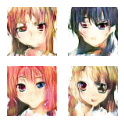

2/2 [==============================] - 0s 82ms/step
discriminator loss: 0.6922776103019714
advesarial loss: 0.8334507346153259


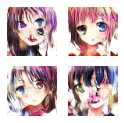

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6862656474113464
advesarial loss: 0.8951338529586792


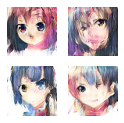

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6761497259140015
advesarial loss: 0.6820535659790039


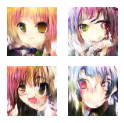

discriminator loss: 0.6761497259140015
advesarial loss: 0.6820535659790039
2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6977555751800537
advesarial loss: 0.5541968941688538


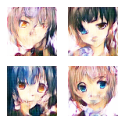

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6845096945762634
advesarial loss: 1.0564875602722168


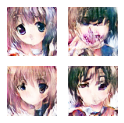

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6921510100364685
advesarial loss: 0.9119486212730408


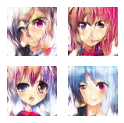

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.7061036825180054
advesarial loss: 0.6492486596107483


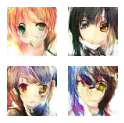

2/2 [==============================] - 0s 88ms/step


discriminator loss: 0.6799513697624207
advesarial loss: 0.8084361553192139


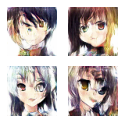

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.7337802052497864
advesarial loss: 0.6551657915115356


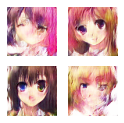

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.653784453868866
advesarial loss: 0.9195221662521362


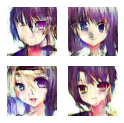

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6724716424942017
advesarial loss: 0.9654354453086853


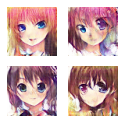

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6953027248382568
advesarial loss: 0.9073947072029114


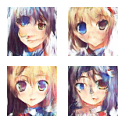

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6950041055679321
advesarial loss: 0.6886874437332153


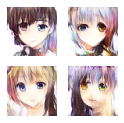

discriminator loss: 0.6950041055679321
advesarial loss: 0.6886874437332153
2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.7693931460380554
advesarial loss: 0.7642771601676941


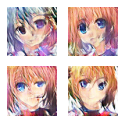

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6885879635810852
advesarial loss: 1.1108824014663696


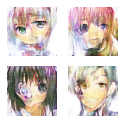

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6625869870185852
advesarial loss: 0.8985045552253723


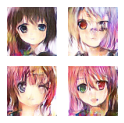

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7061070799827576
advesarial loss: 0.6470985412597656


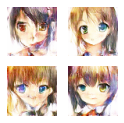

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.7401837110519409
advesarial loss: 0.7448184490203857


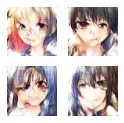

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6818929314613342
advesarial loss: 0.720770537853241


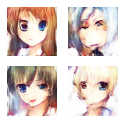

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6603793501853943
advesarial loss: 0.8129777908325195


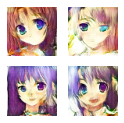

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6739086508750916
advesarial loss: 0.9316432476043701


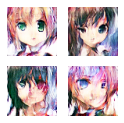

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6197913885116577
advesarial loss: 0.8832619190216064


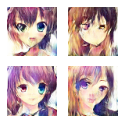

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6877216696739197
advesarial loss: 0.7162251472473145


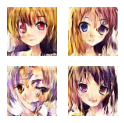

discriminator loss: 0.6877216696739197
advesarial loss: 0.7162251472473145
2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6458929777145386
advesarial loss: 0.8779239654541016


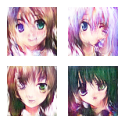

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.8106831312179565
advesarial loss: 1.3777989149093628


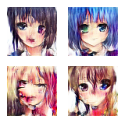

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6591796875
advesarial loss: 0.8080068230628967


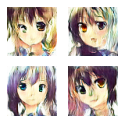

2/2 [==============================] - 0s 87ms/step


discriminator loss: 0.6976580619812012
advesarial loss: 0.8033418655395508


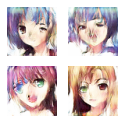

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.6353735327720642
advesarial loss: 1.075730800628662


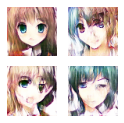

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6728200912475586
advesarial loss: 0.8697183132171631


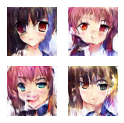

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7369320392608643
advesarial loss: 0.7015368342399597


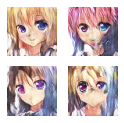

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.6975437998771667
advesarial loss: 0.7130953669548035


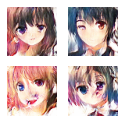

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.7215350270271301
advesarial loss: 0.7423551082611084


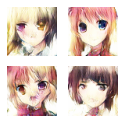

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.7139472961425781
advesarial loss: 1.1004638671875


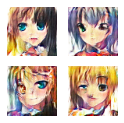

discriminator loss: 0.7139472961425781
advesarial loss: 1.1004638671875
2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.8253411650657654
advesarial loss: 1.2298555374145508


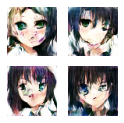

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7048699855804443
advesarial loss: 0.6878244876861572


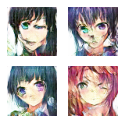

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.693220853805542
advesarial loss: 0.5818657875061035


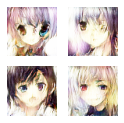

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6468903422355652
advesarial loss: 0.8784844279289246


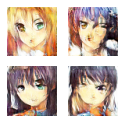

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.6956161260604858
advesarial loss: 0.9072922468185425


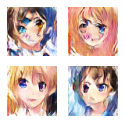

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.66026371717453
advesarial loss: 0.7855328321456909


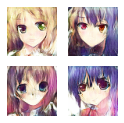

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7001362442970276
advesarial loss: 0.8601458072662354


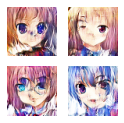

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6799373030662537
advesarial loss: 0.6823320388793945


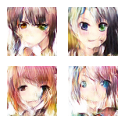

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6972198486328125
advesarial loss: 1.0022103786468506


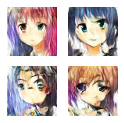

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.70018070936203
advesarial loss: 0.7545704245567322


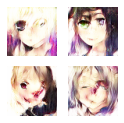

discriminator loss: 0.70018070936203
advesarial loss: 0.7545704245567322
2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.7290903925895691
advesarial loss: 0.83349609375


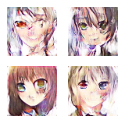

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.688731849193573
advesarial loss: 0.7042649984359741


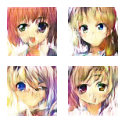

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6582227945327759
advesarial loss: 1.1551505327224731


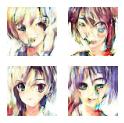

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6922224760055542
advesarial loss: 0.9439768195152283


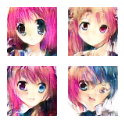

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6945932507514954
advesarial loss: 0.8802873492240906


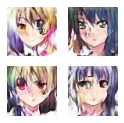

2/2 [==============================] - 0s 87ms/step


discriminator loss: 0.7363454103469849
advesarial loss: 0.7459014058113098


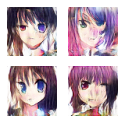

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7280086278915405
advesarial loss: 0.6939378380775452


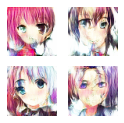

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.7002528309822083
advesarial loss: 0.7315486669540405


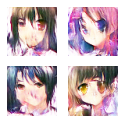

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6765947341918945
advesarial loss: 0.7267544269561768


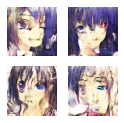

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.692396879196167
advesarial loss: 1.1534574031829834


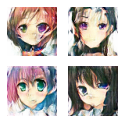

discriminator loss: 0.692396879196167
advesarial loss: 1.1534574031829834
2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.7006213665008545
advesarial loss: 0.8436200022697449


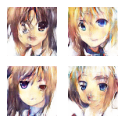

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.7110432982444763
advesarial loss: 1.2173787355422974


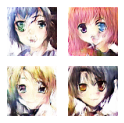

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.7266032099723816
advesarial loss: 0.9471747875213623


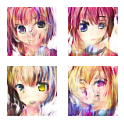

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.7191798686981201
advesarial loss: 0.9535320997238159


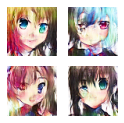

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.8003583550453186
advesarial loss: 1.128074288368225


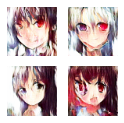

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.6623290777206421
advesarial loss: 0.7434977293014526


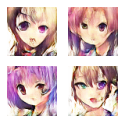

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7081790566444397
advesarial loss: 0.7441705465316772


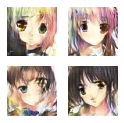

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6849243640899658
advesarial loss: 0.6032937169075012


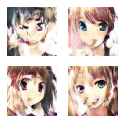

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7099792957305908
advesarial loss: 0.8403297066688538


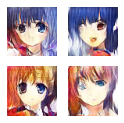

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6972514986991882
advesarial loss: 1.1459863185882568


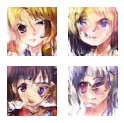

discriminator loss: 0.6972514986991882
advesarial loss: 1.1459863185882568
2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6809839606285095
advesarial loss: 0.8583770394325256


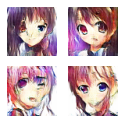

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.6911599636077881
advesarial loss: 1.0652756690979004


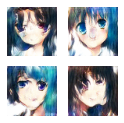

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6784029006958008
advesarial loss: 0.7732232809066772


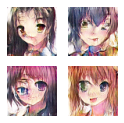

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.7053344249725342
advesarial loss: 0.7718561291694641


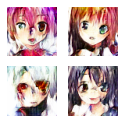

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6726507544517517
advesarial loss: 0.7744084000587463


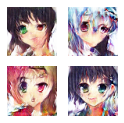

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.5818972587585449
advesarial loss: 1.2166107892990112


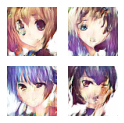

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6086668968200684
advesarial loss: 0.8840767741203308


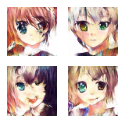

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.7191752195358276
advesarial loss: 1.2670831680297852


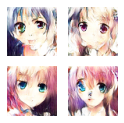

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6768484115600586
advesarial loss: 0.9461323618888855


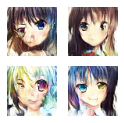

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.7256153225898743
advesarial loss: 1.0237599611282349


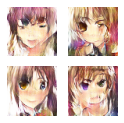

discriminator loss: 0.7256153225898743
advesarial loss: 1.0237599611282349
2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6834936141967773
advesarial loss: 0.9449928998947144


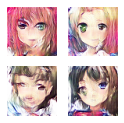

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.7101331949234009
advesarial loss: 1.0395878553390503


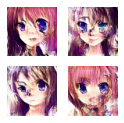

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6811707019805908
advesarial loss: 0.9605828523635864


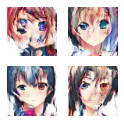

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.677367627620697
advesarial loss: 1.1414098739624023


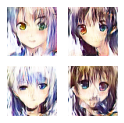

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.6977378129959106
advesarial loss: 0.799551784992218


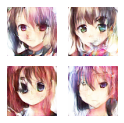

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.677077054977417
advesarial loss: 0.8366072177886963


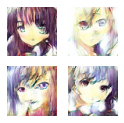

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6502445936203003
advesarial loss: 1.102824330329895


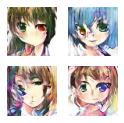

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.7286452054977417
advesarial loss: 1.0132097005844116


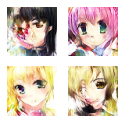

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7157056927680969
advesarial loss: 0.830669105052948


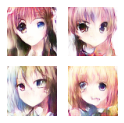

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6534464955329895
advesarial loss: 0.778590202331543


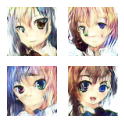

discriminator loss: 0.6534464955329895
advesarial loss: 0.778590202331543
2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7039337754249573
advesarial loss: 0.7614052891731262


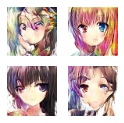

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6818631887435913
advesarial loss: 0.7918185591697693


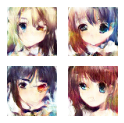

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6680158376693726
advesarial loss: 0.8188969492912292


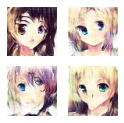

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7245547771453857
advesarial loss: 1.2208298444747925


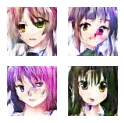

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6199063062667847
advesarial loss: 1.5976183414459229


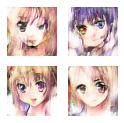

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6647533774375916
advesarial loss: 0.9920434951782227


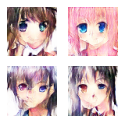

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.644988477230072
advesarial loss: 0.8891884684562683


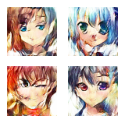

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.6768811345100403
advesarial loss: 1.1269030570983887


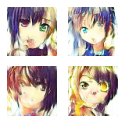

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6667053699493408
advesarial loss: 0.7633799910545349


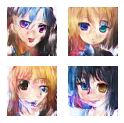

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6705081462860107
advesarial loss: 0.6089985966682434


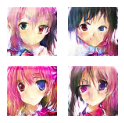

discriminator loss: 0.6705081462860107
advesarial loss: 0.6089985966682434
2/2 [==============================] - 0s 84ms/step
discriminator loss: 0.6446993350982666
advesarial loss: 0.9707304835319519


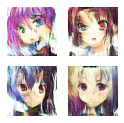

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6208670735359192
advesarial loss: 0.9113370180130005


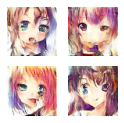

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7413085103034973
advesarial loss: 1.029321551322937


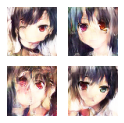

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.7784633636474609
advesarial loss: 1.1824232339859009


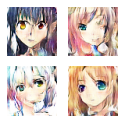

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7413490414619446
advesarial loss: 1.1597927808761597


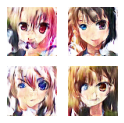

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6459858417510986
advesarial loss: 1.062630534172058


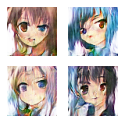

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.5889049172401428
advesarial loss: 0.9626057744026184


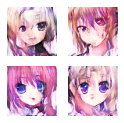

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.639166533946991
advesarial loss: 0.8656926155090332


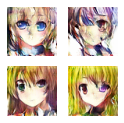

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6751709580421448
advesarial loss: 0.7691106796264648


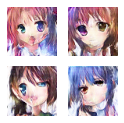

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.7071959972381592
advesarial loss: 0.5559834241867065


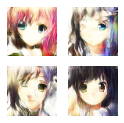

discriminator loss: 0.7071959972381592
advesarial loss: 0.5559834241867065
2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6633377075195312
advesarial loss: 0.8237948417663574


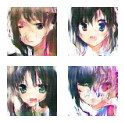

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.6847293376922607
advesarial loss: 1.071049690246582


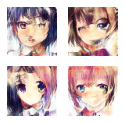

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6782567501068115
advesarial loss: 0.8703702688217163


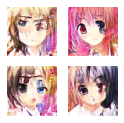

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.7055572271347046
advesarial loss: 1.2242331504821777


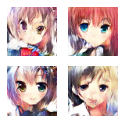

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6945600509643555
advesarial loss: 0.6010567545890808


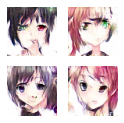

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6796276569366455
advesarial loss: 0.9255673885345459


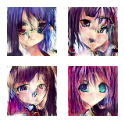

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.7130650281906128
advesarial loss: 1.0737810134887695


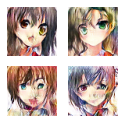

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.68414306640625
advesarial loss: 0.6248202919960022


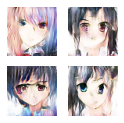

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6345455050468445
advesarial loss: 0.8384354114532471


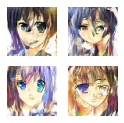

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6187198758125305
advesarial loss: 0.8478338718414307


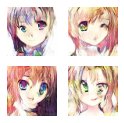

discriminator loss: 0.6187198758125305
advesarial loss: 0.8478338718414307
2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6674807071685791
advesarial loss: 0.7834514379501343


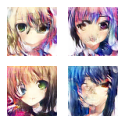

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.744787871837616
advesarial loss: 1.0638855695724487


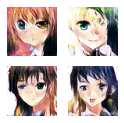

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7050422430038452
advesarial loss: 0.9593709111213684


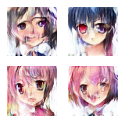

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7019532322883606
advesarial loss: 0.6191232204437256


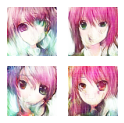

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.7352463006973267
advesarial loss: 1.4999918937683105


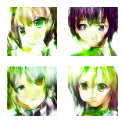

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6670092940330505
advesarial loss: 0.7601426839828491


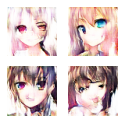

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.7309951186180115
advesarial loss: 1.2206224203109741


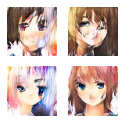

2/2 [==============================] - 0s 79ms/step
discriminator loss: 0.8695241808891296
advesarial loss: 1.0935654640197754


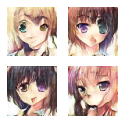

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.7182461023330688
advesarial loss: 1.104280948638916


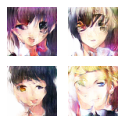

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6720707416534424
advesarial loss: 1.2057751417160034


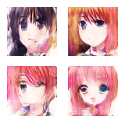

discriminator loss: 0.6720707416534424
advesarial loss: 1.2057751417160034
2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.7536364793777466
advesarial loss: 0.9324198961257935


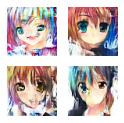

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.710527777671814
advesarial loss: 1.098447322845459


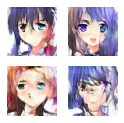

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7040889263153076
advesarial loss: 0.4985658824443817


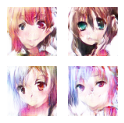

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.636275053024292
advesarial loss: 0.8129640221595764


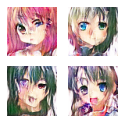

2/2 [==============================] - 0s 82ms/step


discriminator loss: 1.8441920280456543
advesarial loss: 7.91138219833374


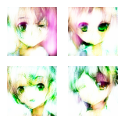

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.31869539618492126
advesarial loss: 1.7367035150527954


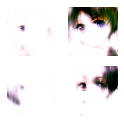

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6289607882499695
advesarial loss: 1.0711241960525513


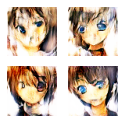

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.67720627784729
advesarial loss: 1.0625063180923462


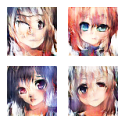

2/2 [==============================] - 0s 87ms/step


discriminator loss: 0.7316610813140869
advesarial loss: 1.3388798236846924


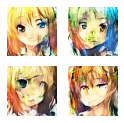

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6879392266273499
advesarial loss: 0.7798891067504883


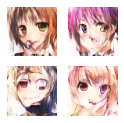

discriminator loss: 0.6879392266273499
advesarial loss: 0.7798891067504883
2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6631430387496948
advesarial loss: 0.6366262435913086


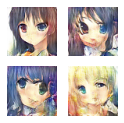

2/2 [==============================] - 0s 77ms/step


discriminator loss: 0.6847195029258728
advesarial loss: 0.7258433103561401


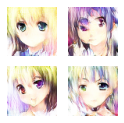

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6724931001663208
advesarial loss: 0.8005412817001343


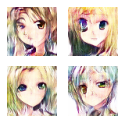

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6800112128257751
advesarial loss: 0.7799794673919678


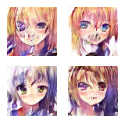

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.461194783449173
advesarial loss: 1.932992696762085


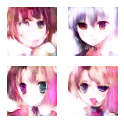

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.5561238527297974
advesarial loss: 0.8982623219490051


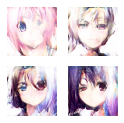

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6630018949508667
advesarial loss: 0.8213028311729431


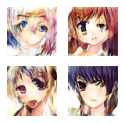

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6799088716506958
advesarial loss: 0.878191351890564


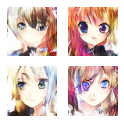

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6429988145828247
advesarial loss: 0.849722683429718


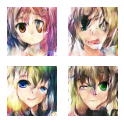

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.6908375024795532
advesarial loss: 0.719280481338501


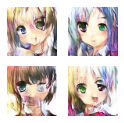

discriminator loss: 0.6908375024795532
advesarial loss: 0.719280481338501
2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7124226689338684
advesarial loss: 0.7239876985549927


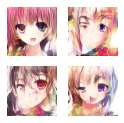

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6800616979598999
advesarial loss: 0.7928227186203003


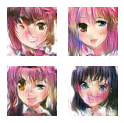

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.7226783633232117
advesarial loss: 0.7109112739562988


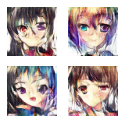

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.7488270401954651
advesarial loss: 1.265015959739685


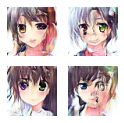

2/2 [==============================] - 0s 81ms/step
discriminator loss: 0.7244077920913696
advesarial loss: 1.45304536819458


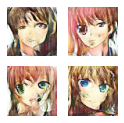

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.5107473134994507
advesarial loss: 0.8514247536659241


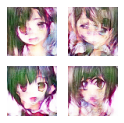

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.8096895217895508
advesarial loss: 1.1952168941497803


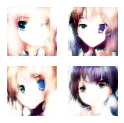

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.5565416216850281
advesarial loss: 0.6420365571975708


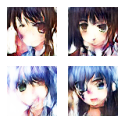

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7351125478744507
advesarial loss: 0.5093705654144287


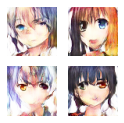

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.6593198776245117
advesarial loss: 0.9537830352783203


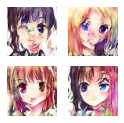

discriminator loss: 0.6593198776245117
advesarial loss: 0.9537830352783203
2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6402111053466797
advesarial loss: 1.1492526531219482


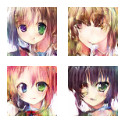

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6688138246536255
advesarial loss: 0.7045302987098694


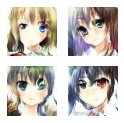

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.662893533706665
advesarial loss: 1.1956162452697754


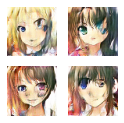

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6765493750572205
advesarial loss: 0.7958709001541138


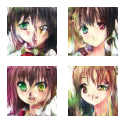

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.7334807515144348
advesarial loss: 1.578928828239441


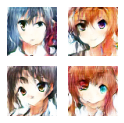

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.8705346584320068
advesarial loss: 0.653927743434906


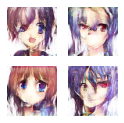

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6983761191368103
advesarial loss: 1.1592926979064941


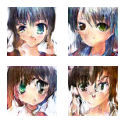

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6933043003082275
advesarial loss: 0.7365572452545166


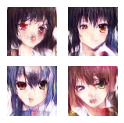

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6696054339408875
advesarial loss: 0.6274794936180115


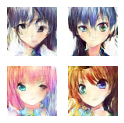

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.15111708641052246
advesarial loss: 2.29887056350708


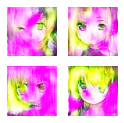

discriminator loss: 0.15111708641052246
advesarial loss: 2.29887056350708
2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.4021846055984497
advesarial loss: 1.348940134048462


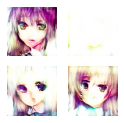

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7012764811515808
advesarial loss: 0.7454158067703247


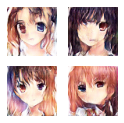

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6648486852645874
advesarial loss: 1.2207226753234863


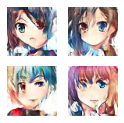

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.7418192625045776
advesarial loss: 1.1640548706054688


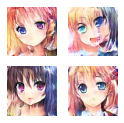

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6904821395874023
advesarial loss: 0.8458721041679382


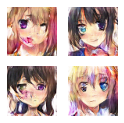

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.66701340675354
advesarial loss: 0.7185488343238831


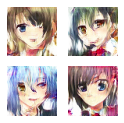

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6591955423355103
advesarial loss: 1.1616812944412231


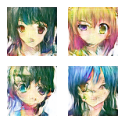

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6279232501983643
advesarial loss: 1.0764552354812622


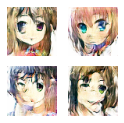

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6898005604743958
advesarial loss: 0.9662765860557556


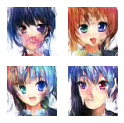

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6399829983711243
advesarial loss: 1.1653848886489868


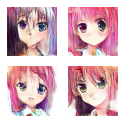

discriminator loss: 0.6399829983711243
advesarial loss: 1.1653848886489868
2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.8697089552879333
advesarial loss: 1.4031128883361816


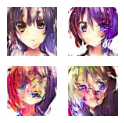

2/2 [==============================] - 0s 79ms/step
discriminator loss: 0.6577664613723755
advesarial loss: 1.085658073425293


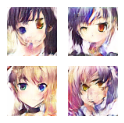

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6705011129379272
advesarial loss: 0.8848898410797119


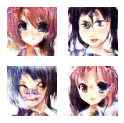

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.703241765499115
advesarial loss: 0.7552323341369629


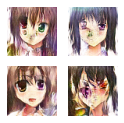

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6134964823722839
advesarial loss: 1.154797911643982


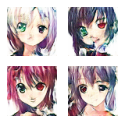

2/2 [==============================] - 0s 76ms/step


discriminator loss: 0.6685659289360046
advesarial loss: 1.0983140468597412


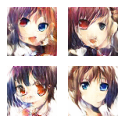

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.7402812838554382
advesarial loss: 0.6361086368560791


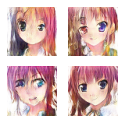

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.8542152643203735
advesarial loss: 1.354703664779663


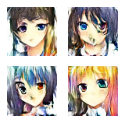

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.72092604637146
advesarial loss: 1.119296908378601


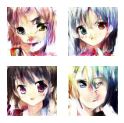

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7573134899139404
advesarial loss: 0.5879524946212769


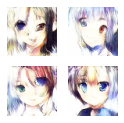

discriminator loss: 0.7573134899139404
advesarial loss: 0.5879524946212769
2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7161208987236023
advesarial loss: 1.1864068508148193


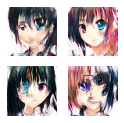

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.7326705455780029
advesarial loss: 0.7055827379226685


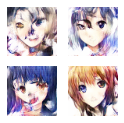

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6583758592605591
advesarial loss: 0.7645111083984375


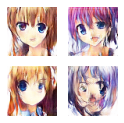

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.740108072757721
advesarial loss: 0.8472094535827637


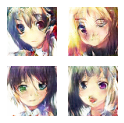

2/2 [==============================] - 0s 80ms/step
discriminator loss: 0.6927863955497742
advesarial loss: 0.8179567456245422


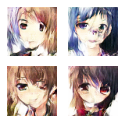

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6698033213615417
advesarial loss: 0.7559859156608582


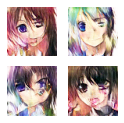

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6170175075531006
advesarial loss: 1.0079083442687988


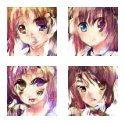

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6579318046569824
advesarial loss: 0.785297691822052


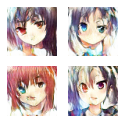

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6977389454841614
advesarial loss: 1.2025902271270752


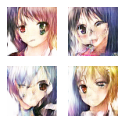

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.6749461889266968
advesarial loss: 0.8487222790718079


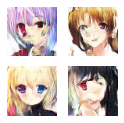

discriminator loss: 0.6749461889266968
advesarial loss: 0.8487222790718079
2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7387831211090088
advesarial loss: 0.5381542444229126


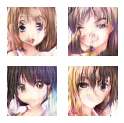

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.6699636578559875
advesarial loss: 0.881965696811676


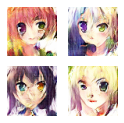

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.5968639850616455
advesarial loss: 0.8618403077125549


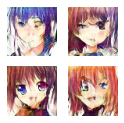

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.6030355095863342
advesarial loss: 1.3182004690170288


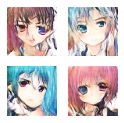

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6915122270584106
advesarial loss: 1.3792989253997803


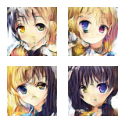

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6771336197853088
advesarial loss: 0.8742458820343018


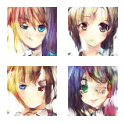

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6710598468780518
advesarial loss: 1.0123510360717773


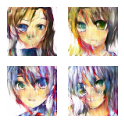

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.8779726624488831
advesarial loss: 1.156632900238037


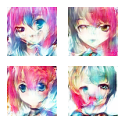

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6927368640899658
advesarial loss: 1.062611699104309


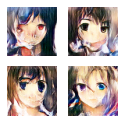

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6973828077316284
advesarial loss: 1.1033002138137817


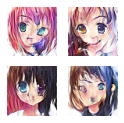

discriminator loss: 0.6973828077316284
advesarial loss: 1.1033002138137817
2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.6833961606025696
advesarial loss: 0.8460020422935486


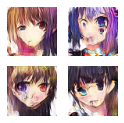

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.5989217162132263
advesarial loss: 1.4423390626907349


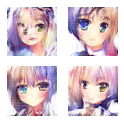

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.661089301109314
advesarial loss: 0.9870287775993347


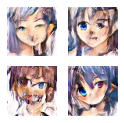

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7664057016372681
advesarial loss: 1.130553126335144


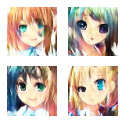

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.740084707736969
advesarial loss: 0.8211868405342102


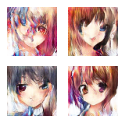

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.7123804688453674
advesarial loss: 0.9916250705718994


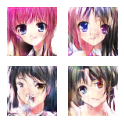

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.7188640236854553
advesarial loss: 1.0027363300323486


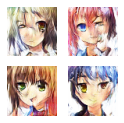

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.7757312059402466
advesarial loss: 1.1954236030578613


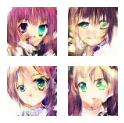

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6145241260528564
advesarial loss: 1.5419728755950928


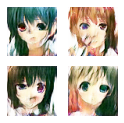

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.6864854693412781
advesarial loss: 0.8606625199317932


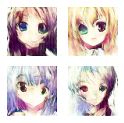

discriminator loss: 0.6864854693412781
advesarial loss: 0.8606625199317932
2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.6912892460823059
advesarial loss: 0.7647385597229004


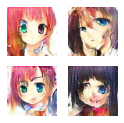

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.68757164478302
advesarial loss: 0.6361045241355896


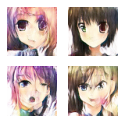

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.7090319395065308
advesarial loss: 0.749937891960144


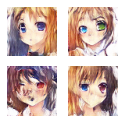

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.67867511510849
advesarial loss: 1.2552664279937744


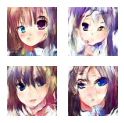

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.7817612290382385
advesarial loss: 1.0204977989196777


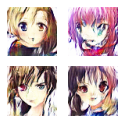

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.7730400562286377
advesarial loss: 1.2127679586410522


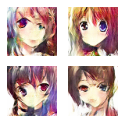

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6383754014968872
advesarial loss: 1.2384799718856812


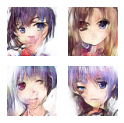

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6617513298988342
advesarial loss: 0.8566775321960449


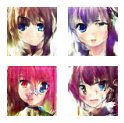

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7132412195205688
advesarial loss: 0.6916409134864807


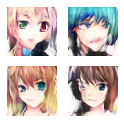

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6931523084640503
advesarial loss: 1.1785290241241455


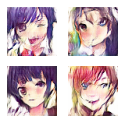

discriminator loss: 0.6931523084640503
advesarial loss: 1.1785290241241455
2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6591912508010864
advesarial loss: 0.938025712966919


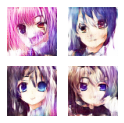

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6858676671981812
advesarial loss: 0.7043254375457764


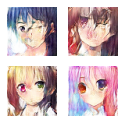

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6399451494216919
advesarial loss: 0.7599599361419678


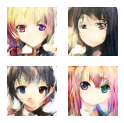

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.7307630777359009
advesarial loss: 0.7880585193634033


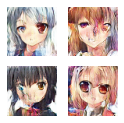

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.7124267816543579
advesarial loss: 0.9397364854812622


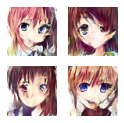

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.9288356304168701
advesarial loss: 1.3139643669128418


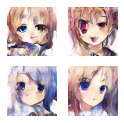

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6542697548866272
advesarial loss: 0.9546090364456177


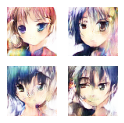

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6899541616439819
advesarial loss: 1.139033317565918


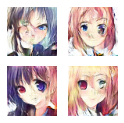

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.7198389768600464
advesarial loss: 0.7916754484176636


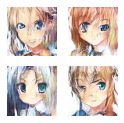

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.7594560980796814
advesarial loss: 0.34508198499679565


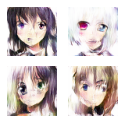

discriminator loss: 0.7594560980796814
advesarial loss: 0.34508198499679565
2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6528926491737366
advesarial loss: 0.7752158641815186


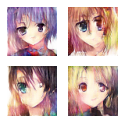

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6819913387298584
advesarial loss: 1.0600255727767944


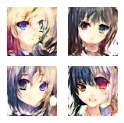

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7065163254737854
advesarial loss: 1.189444661140442


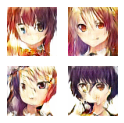

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.7609812021255493
advesarial loss: 1.1798878908157349


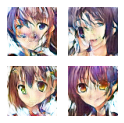

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.6215959191322327
advesarial loss: 0.8151848316192627


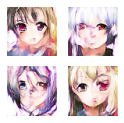

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6757404804229736
advesarial loss: 0.6321402788162231


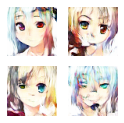

2/2 [==============================] - 0s 87ms/step


discriminator loss: 0.6677472591400146
advesarial loss: 0.8673301339149475


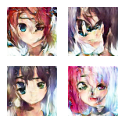

2/2 [==============================] - 0s 87ms/step


discriminator loss: 0.7366893887519836
advesarial loss: 0.7160139083862305


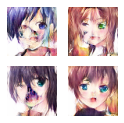

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6858793497085571
advesarial loss: 0.7857875227928162


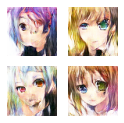

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.7088496685028076
advesarial loss: 0.7476814985275269


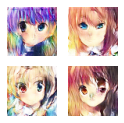

discriminator loss: 0.7088496685028076
advesarial loss: 0.7476814985275269
2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.5859382748603821
advesarial loss: 0.9874895811080933


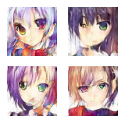

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7378860116004944
advesarial loss: 0.804578423500061


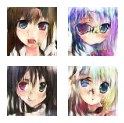

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.7030848860740662
advesarial loss: 1.0081723928451538


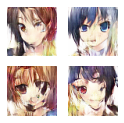

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.7723631858825684
advesarial loss: 0.5909099578857422


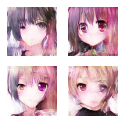

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.6903315186500549
advesarial loss: 0.853987991809845


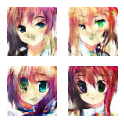

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.700374186038971
advesarial loss: 1.1267062425613403


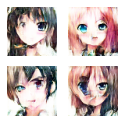

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.6860515475273132
advesarial loss: 1.002340316772461


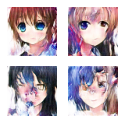

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6575638651847839
advesarial loss: 0.9395318627357483


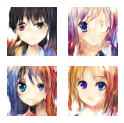

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6865251064300537
advesarial loss: 0.7048542499542236


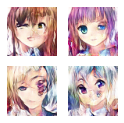

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6449613571166992
advesarial loss: 0.6395828723907471


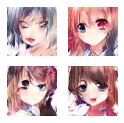

discriminator loss: 0.6449613571166992
advesarial loss: 0.6395828723907471
2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6784310936927795
advesarial loss: 0.8456457257270813


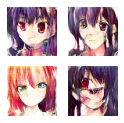

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6862537860870361
advesarial loss: 1.9498108625411987


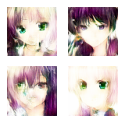

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.7172125577926636
advesarial loss: 1.042147159576416


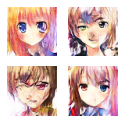

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7260894179344177
advesarial loss: 1.079174518585205


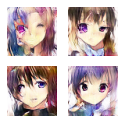

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.8177474737167358
advesarial loss: 0.9078002572059631


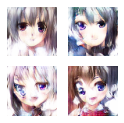

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.7156245708465576
advesarial loss: 1.1736855506896973


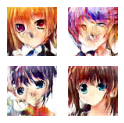

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.5636868476867676
advesarial loss: 1.7412995100021362


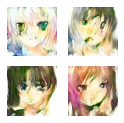

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6411128640174866
advesarial loss: 0.9359920024871826


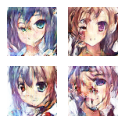

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6720154881477356
advesarial loss: 1.229601263999939


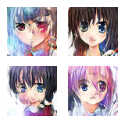

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6615821719169617
advesarial loss: 0.8884301781654358


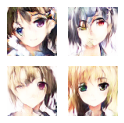

discriminator loss: 0.6615821719169617
advesarial loss: 0.8884301781654358
2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6686897873878479
advesarial loss: 0.7462722063064575


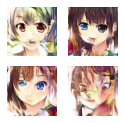

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.723686695098877
advesarial loss: 0.6867833733558655


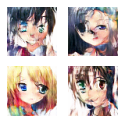

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.7010744214057922
advesarial loss: 0.9190146327018738


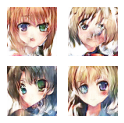

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.6585628986358643
advesarial loss: 0.9101830720901489


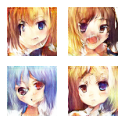

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6367676854133606
advesarial loss: 1.0439093112945557


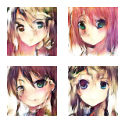

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6674306392669678
advesarial loss: 0.925969660282135


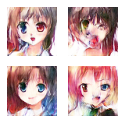

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.664715051651001
advesarial loss: 0.8826541900634766


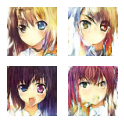

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.670612096786499
advesarial loss: 0.8093714118003845


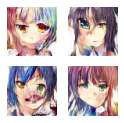

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.7331822514533997
advesarial loss: 0.7984353303909302


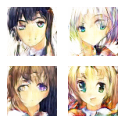

2/2 [==============================] - 0s 77ms/step


discriminator loss: 0.6561740040779114
advesarial loss: 0.923084020614624


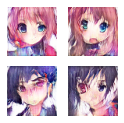

discriminator loss: 0.6561740040779114
advesarial loss: 0.923084020614624
2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.5945842266082764
advesarial loss: 0.8265751600265503


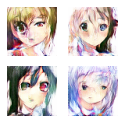

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6078086495399475
advesarial loss: 0.7568779587745667


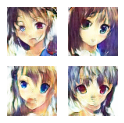

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.724613606929779
advesarial loss: 0.9911267757415771


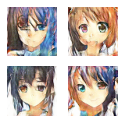

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7349650263786316
advesarial loss: 0.7382503151893616


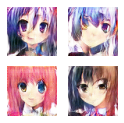

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.6873088479042053
advesarial loss: 1.3912593126296997


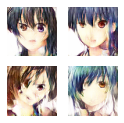

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.7184221744537354
advesarial loss: 1.079752802848816


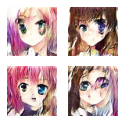

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.7246077656745911
advesarial loss: 0.7158904075622559


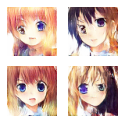

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.8190296292304993
advesarial loss: 0.4865001440048218


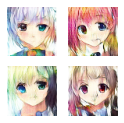

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.7170584201812744
advesarial loss: 0.6655349731445312


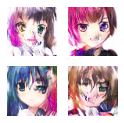

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6708442568778992
advesarial loss: 0.9363304972648621


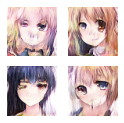

discriminator loss: 0.6708442568778992
advesarial loss: 0.9363304972648621
2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7343953251838684
advesarial loss: 1.3762221336364746


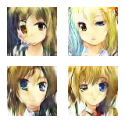

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6518450975418091
advesarial loss: 0.7601773738861084


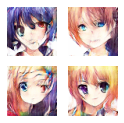

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6615886688232422
advesarial loss: 0.8951897025108337


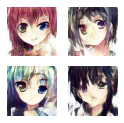

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.6922447681427002
advesarial loss: 1.0538153648376465


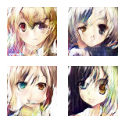

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.6619789004325867
advesarial loss: 0.8004855513572693


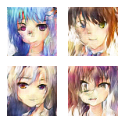

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6761503219604492
advesarial loss: 0.70914626121521


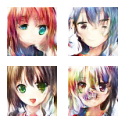

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.7333894371986389
advesarial loss: 1.2879084348678589


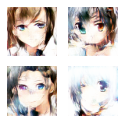

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6758782267570496
advesarial loss: 0.9941257834434509


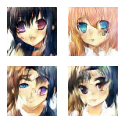

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.7676937580108643
advesarial loss: 0.6145460605621338


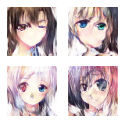

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7048572301864624
advesarial loss: 1.2100385427474976


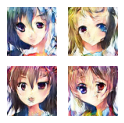

discriminator loss: 0.7048572301864624
advesarial loss: 1.2100385427474976
2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7012174129486084
advesarial loss: 1.320039987564087


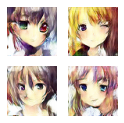

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.767097532749176
advesarial loss: 1.2852011919021606


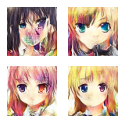

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.7043445706367493
advesarial loss: 0.9411025643348694


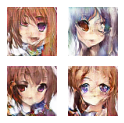

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.7329506278038025
advesarial loss: 1.359508752822876


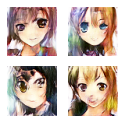

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6955326795578003
advesarial loss: 0.8847873210906982


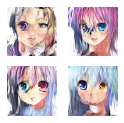

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.6981856822967529
advesarial loss: 1.0166493654251099


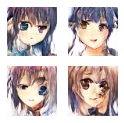

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7441856861114502
advesarial loss: 1.1522026062011719


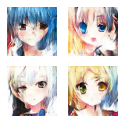

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6721603870391846
advesarial loss: 1.07998526096344


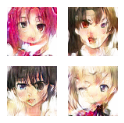

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.7233588695526123
advesarial loss: 0.6740333437919617


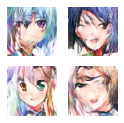

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6800771355628967
advesarial loss: 0.8328856825828552


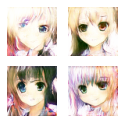

discriminator loss: 0.6800771355628967
advesarial loss: 0.8328856825828552
2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.6815214157104492
advesarial loss: 0.9057109355926514


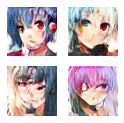

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.695580780506134
advesarial loss: 0.7310065627098083


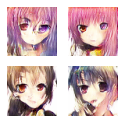

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.7229210734367371
advesarial loss: 1.5069348812103271


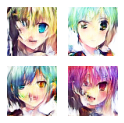

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6360292434692383
advesarial loss: 1.0666078329086304


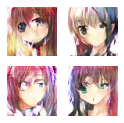

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6934729814529419
advesarial loss: 0.976085364818573


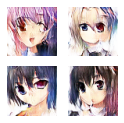

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6877413988113403
advesarial loss: 1.1736818552017212


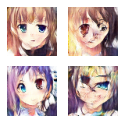

2/2 [==============================] - 0s 82ms/step
discriminator loss: 0.71748948097229
advesarial loss: 0.9989392757415771


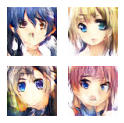

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6790032982826233
advesarial loss: 0.9604367017745972


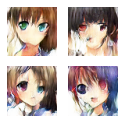

2/2 [==============================] - 0s 88ms/step


discriminator loss: 0.6693927049636841
advesarial loss: 1.2506970167160034


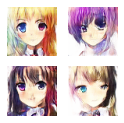

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6635701656341553
advesarial loss: 0.9293907880783081


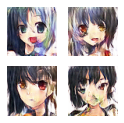

discriminator loss: 0.6635701656341553
advesarial loss: 0.9293907880783081
2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6208943128585815
advesarial loss: 0.9918947219848633


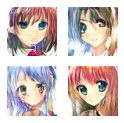

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6961560845375061
advesarial loss: 1.018068790435791


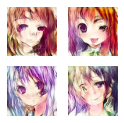

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6988479495048523
advesarial loss: 0.9291930794715881


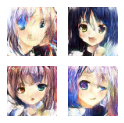

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6678850650787354
advesarial loss: 0.8302074670791626


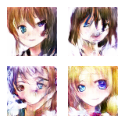

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.5684407353401184
advesarial loss: 1.206463098526001


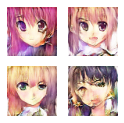

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.675878643989563
advesarial loss: 1.1848448514938354


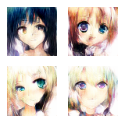

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6652657985687256
advesarial loss: 1.0736424922943115


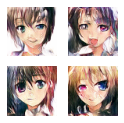

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.8375961184501648
advesarial loss: 1.7082418203353882


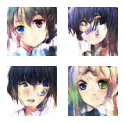

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6805021166801453
advesarial loss: 0.771894633769989


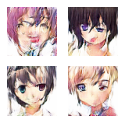

2/2 [==============================] - 0s 82ms/step
discriminator loss: 0.7094340920448303
advesarial loss: 0.9216853380203247


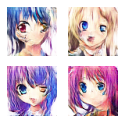

discriminator loss: 0.7094340920448303
advesarial loss: 0.9216853380203247
2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7757115960121155
advesarial loss: 1.228344440460205


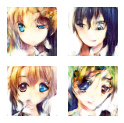

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6872720718383789
advesarial loss: 1.2181237936019897


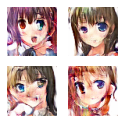

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6742260456085205
advesarial loss: 1.1926610469818115


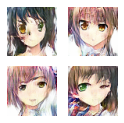

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6563676595687866
advesarial loss: 0.9083918333053589


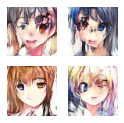

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6884979605674744
advesarial loss: 1.0506134033203125


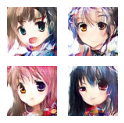

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7181788086891174
advesarial loss: 1.172935962677002


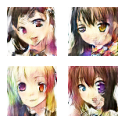

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6931604743003845
advesarial loss: 0.9758673906326294


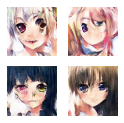

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6770965456962585
advesarial loss: 1.0482358932495117


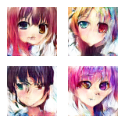

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.711394727230072
advesarial loss: 0.6477161049842834


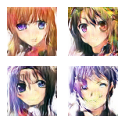

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6430705785751343
advesarial loss: 1.5347501039505005


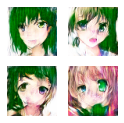

discriminator loss: 0.6430705785751343
advesarial loss: 1.5347501039505005
2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6448727250099182
advesarial loss: 0.8294517397880554


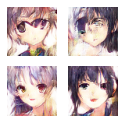

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6858947277069092
advesarial loss: 1.0124846696853638


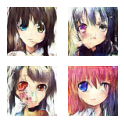

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.6719213128089905
advesarial loss: 1.010733962059021


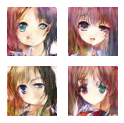

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.7006869316101074
advesarial loss: 0.8730530738830566


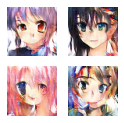

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7699255347251892
advesarial loss: 1.5043902397155762


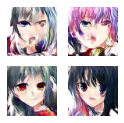

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6642467975616455
advesarial loss: 0.782275378704071


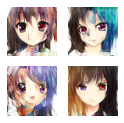

2/2 [==============================] - 0s 87ms/step


discriminator loss: 0.6979315280914307
advesarial loss: 0.6796960830688477


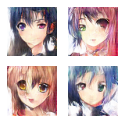

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7152075171470642
advesarial loss: 0.6960586309432983


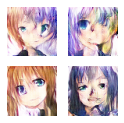

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.6585585474967957
advesarial loss: 0.9749876856803894


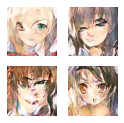

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.5522341132164001
advesarial loss: 2.483551025390625


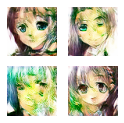

discriminator loss: 0.5522341132164001
advesarial loss: 2.483551025390625
2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6740650534629822
advesarial loss: 0.9520844221115112


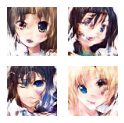

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6896438598632812
advesarial loss: 0.9271311163902283


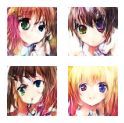

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6978808641433716
advesarial loss: 0.9775376915931702


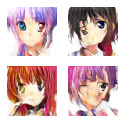

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6454178690910339
advesarial loss: 0.805863618850708


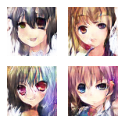

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6883782148361206
advesarial loss: 0.7310280799865723


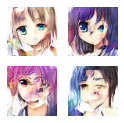

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.8208205699920654
advesarial loss: 0.6334454417228699


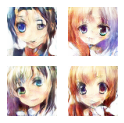

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6560960412025452
advesarial loss: 0.8413415551185608


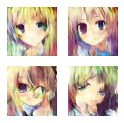

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6499757766723633
advesarial loss: 0.9903537034988403


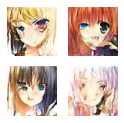

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6771692633628845
advesarial loss: 0.7869532704353333


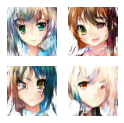

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7181418538093567
advesarial loss: 0.777728796005249


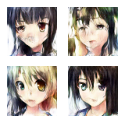

discriminator loss: 0.7181418538093567
advesarial loss: 0.777728796005249
2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6661732792854309
advesarial loss: 0.7897579669952393


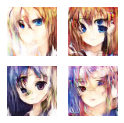

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.7004849314689636
advesarial loss: 0.7756488919258118


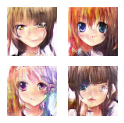

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.885335385799408
advesarial loss: 1.0810942649841309


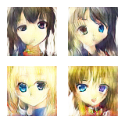

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7179161310195923
advesarial loss: 1.284017562866211


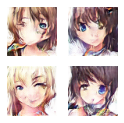

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6271683573722839
advesarial loss: 1.3733712434768677


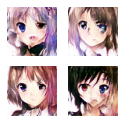

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6636062860488892
advesarial loss: 0.9282566905021667


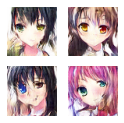

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.8020871877670288
advesarial loss: 1.2357723712921143


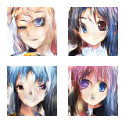

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6386250257492065
advesarial loss: 0.9520195722579956


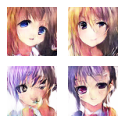

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.666128396987915
advesarial loss: 0.8353021144866943


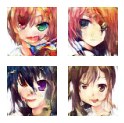

2/2 [==============================] - 0s 83ms/step
discriminator loss: 0.7287850975990295
advesarial loss: 0.6387444138526917


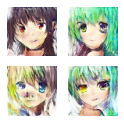

discriminator loss: 0.7287850975990295
advesarial loss: 0.6387444138526917
2/2 [==============================] - 0s 87ms/step


discriminator loss: 0.8175095915794373
advesarial loss: 1.6983088254928589


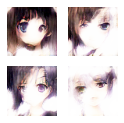

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6787154674530029
advesarial loss: 0.8816806674003601


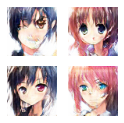

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6507726907730103
advesarial loss: 1.0269747972488403


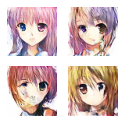

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7153805494308472
advesarial loss: 0.7904848456382751


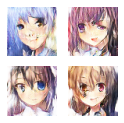

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6595096588134766
advesarial loss: 0.9701851606369019


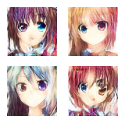

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.646152675151825
advesarial loss: 1.1168633699417114


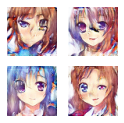

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.6468574404716492
advesarial loss: 1.0793417692184448


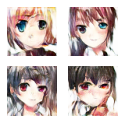

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6715571880340576
advesarial loss: 1.1945797204971313


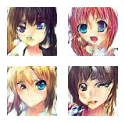

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.8800875544548035
advesarial loss: 1.4042513370513916


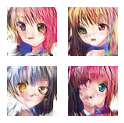

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.6350880265235901
advesarial loss: 0.8456084728240967


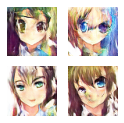

discriminator loss: 0.6350880265235901
advesarial loss: 0.8456084728240967
2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.64817214012146
advesarial loss: 0.7397342324256897


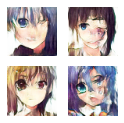

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6466302275657654
advesarial loss: 1.1890581846237183


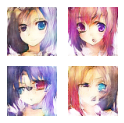

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.6181409955024719
advesarial loss: 1.1998604536056519


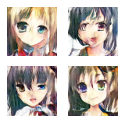

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.7023353576660156
advesarial loss: 0.8101135492324829


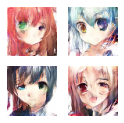

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6602801084518433
advesarial loss: 1.6713942289352417


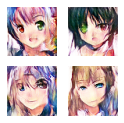

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.7098753452301025
advesarial loss: 0.8789717555046082


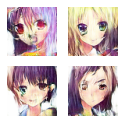

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6227036714553833
advesarial loss: 1.1897706985473633


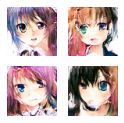

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6807448267936707
advesarial loss: 0.7989480495452881


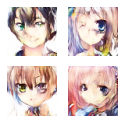

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6790053844451904
advesarial loss: 0.8405963182449341


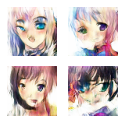

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6792294979095459
advesarial loss: 0.7606036067008972


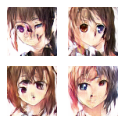

discriminator loss: 0.6792294979095459
advesarial loss: 0.7606036067008972
2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.7458231449127197
advesarial loss: 1.0760127305984497


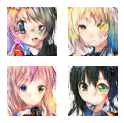

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.7138359546661377
advesarial loss: 0.9945151209831238


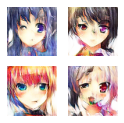

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6355075240135193
advesarial loss: 0.9744309186935425


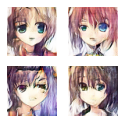

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.5653029680252075
advesarial loss: 0.9746228456497192


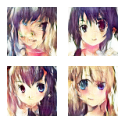

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.727063000202179
advesarial loss: 0.7256991863250732


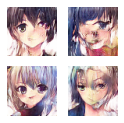

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6557157039642334
advesarial loss: 1.0825802087783813


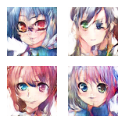

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6852644681930542
advesarial loss: 0.9110051393508911


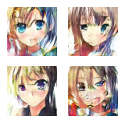

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6781697273254395
advesarial loss: 0.7934704422950745


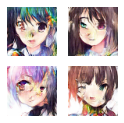

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6756629943847656
advesarial loss: 0.7898873686790466


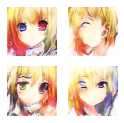

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.7949714660644531
advesarial loss: 1.124366283416748


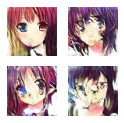

discriminator loss: 0.7949714660644531
advesarial loss: 1.124366283416748
2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6942698955535889
advesarial loss: 0.6804898977279663


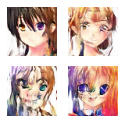

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6947422027587891
advesarial loss: 0.5695597529411316


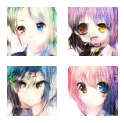

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6305878162384033
advesarial loss: 0.9897330403327942


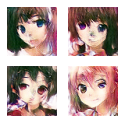

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.690071702003479
advesarial loss: 1.0610332489013672


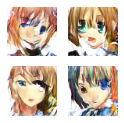

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6162527203559875
advesarial loss: 1.2079812288284302


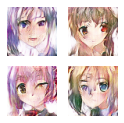

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.5734612941741943
advesarial loss: 1.2184783220291138


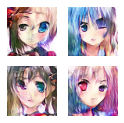

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6522738933563232
advesarial loss: 0.9428588151931763


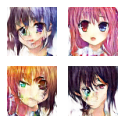

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6922900676727295
advesarial loss: 0.8856675028800964


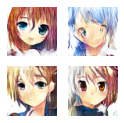

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6385020017623901
advesarial loss: 0.6969002485275269


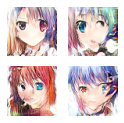

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6918705105781555
advesarial loss: 0.5763394832611084


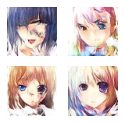

discriminator loss: 0.6918705105781555
advesarial loss: 0.5763394832611084
2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6587194800376892
advesarial loss: 0.9906493425369263


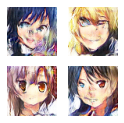

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6814218163490295
advesarial loss: 0.9515401124954224


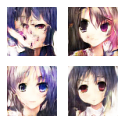

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.7902841567993164
advesarial loss: 0.6516541242599487


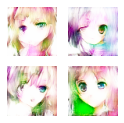

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.44415149092674255
advesarial loss: 2.7317821979522705


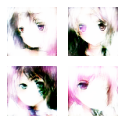

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.8156997561454773
advesarial loss: 1.4503446817398071


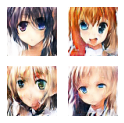

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6442801356315613
advesarial loss: 0.9643193483352661


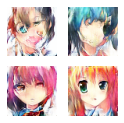

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6674931049346924
advesarial loss: 0.8834733963012695


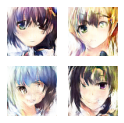

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7751905918121338
advesarial loss: 1.111045241355896


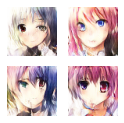

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6835238933563232
advesarial loss: 0.6272792220115662


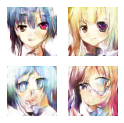

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6604702472686768
advesarial loss: 0.678045392036438


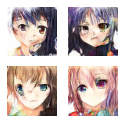

discriminator loss: 0.6604702472686768
advesarial loss: 0.678045392036438
2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.7404597997665405
advesarial loss: 1.0388481616973877


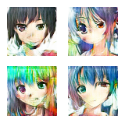

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6602155566215515
advesarial loss: 1.2392771244049072


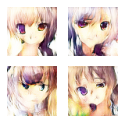

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.6193610429763794
advesarial loss: 0.8948304653167725


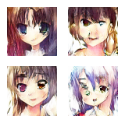

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6767001152038574
advesarial loss: 0.8024219274520874


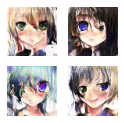

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.677069902420044
advesarial loss: 0.8815488219261169


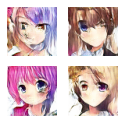

2/2 [==============================] - 0s 85ms/step


discriminator loss: 0.7057240009307861
advesarial loss: 0.8898694515228271


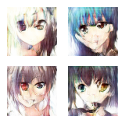

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.5543787479400635
advesarial loss: 1.2530778646469116


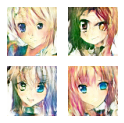

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6434109210968018
advesarial loss: 0.8068910241127014


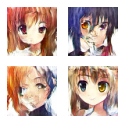

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7347561717033386
advesarial loss: 0.8228477239608765


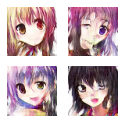

2/2 [==============================] - 0s 75ms/step


discriminator loss: 0.606497049331665
advesarial loss: 0.7972745895385742


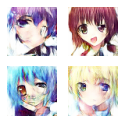

discriminator loss: 0.606497049331665
advesarial loss: 0.7972745895385742
2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.7130908966064453
advesarial loss: 1.0172852277755737


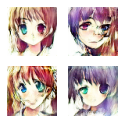

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6486954092979431
advesarial loss: 0.8129307627677917


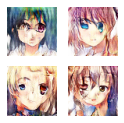

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6878380179405212
advesarial loss: 0.7631192207336426


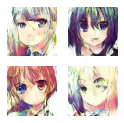

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6884458661079407
advesarial loss: 0.84896320104599


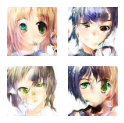

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.8487468361854553
advesarial loss: 0.8754201531410217


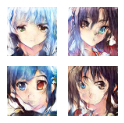

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.5961641669273376
advesarial loss: 0.9428749084472656


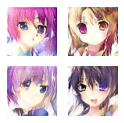

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6898255944252014
advesarial loss: 1.1319971084594727


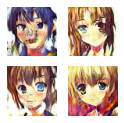

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.8340588808059692
advesarial loss: 1.3061888217926025


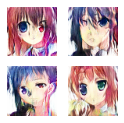

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7280440926551819
advesarial loss: 0.8111509680747986


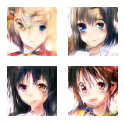

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.774458110332489
advesarial loss: 0.6937634944915771


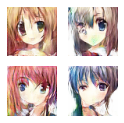

discriminator loss: 0.774458110332489
advesarial loss: 0.6937634944915771
2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6851978302001953
advesarial loss: 1.1315332651138306


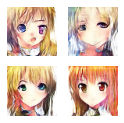

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.6341809034347534
advesarial loss: 1.1686615943908691


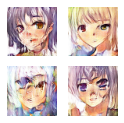

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7654056549072266
advesarial loss: 0.7464772462844849


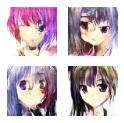

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.5653889179229736
advesarial loss: 1.0822539329528809


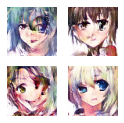

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6222773790359497
advesarial loss: 0.8067371845245361


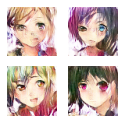

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.6882979273796082
advesarial loss: 0.79266357421875


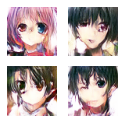

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7527810335159302
advesarial loss: 1.6978803873062134


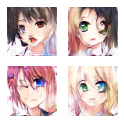

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.7491753697395325
advesarial loss: 1.32523775100708


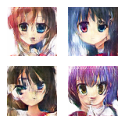

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.741235077381134
advesarial loss: 1.2692102193832397


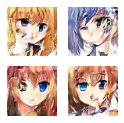

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.687623918056488
advesarial loss: 0.6850290298461914


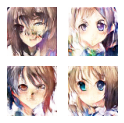

discriminator loss: 0.687623918056488
advesarial loss: 0.6850290298461914
2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.5820071697235107
advesarial loss: 0.9803536534309387


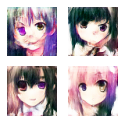

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.6031215190887451
advesarial loss: 1.8025315999984741


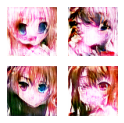

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.5996720790863037
advesarial loss: 1.186255693435669


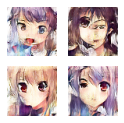

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.7085626721382141
advesarial loss: 1.0975866317749023


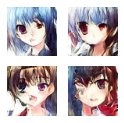

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.6738594174385071
advesarial loss: 1.4868263006210327


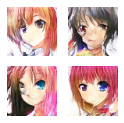

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.7706549763679504
advesarial loss: 1.3717336654663086


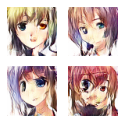

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6647731065750122
advesarial loss: 0.9917569756507874


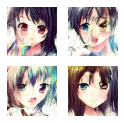

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6898217797279358
advesarial loss: 1.148073673248291


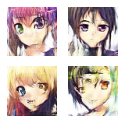

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6784470081329346
advesarial loss: 0.907757043838501


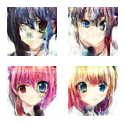

2/2 [==============================] - 0s 72ms/step


discriminator loss: 0.9446756839752197
advesarial loss: 1.1961506605148315


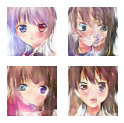

discriminator loss: 0.9446756839752197
advesarial loss: 1.1961506605148315
2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.5613750219345093
advesarial loss: 1.2627629041671753


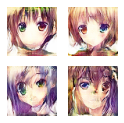

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7444393634796143
advesarial loss: 0.85648512840271


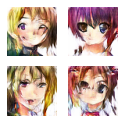

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6826910972595215
advesarial loss: 1.3042937517166138


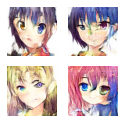

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7031140923500061
advesarial loss: 0.8239471912384033


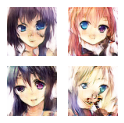

2/2 [==============================] - 0s 79ms/step
discriminator loss: 0.6521751284599304
advesarial loss: 0.9784986972808838


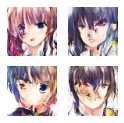

2/2 [==============================] - 0s 81ms/step


discriminator loss: 0.667233943939209
advesarial loss: 1.085693359375


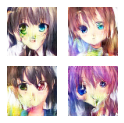

2/2 [==============================] - 0s 79ms/step


discriminator loss: 0.6216180324554443
advesarial loss: 0.9022076725959778


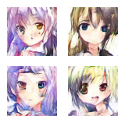

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7012585997581482
advesarial loss: 0.9668892621994019


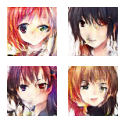

2/2 [==============================] - 0s 84ms/step


discriminator loss: 0.6954011917114258
advesarial loss: 0.9412596821784973


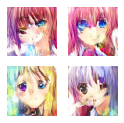

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.7855966091156006
advesarial loss: 0.6186255216598511


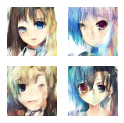

discriminator loss: 0.7855966091156006
advesarial loss: 0.6186255216598511
2/2 [==============================] - 0s 84ms/step


discriminator loss: 1.243693232536316
advesarial loss: 2.4791836738586426


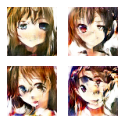

2/2 [==============================] - 0s 83ms/step


discriminator loss: 0.6747710704803467
advesarial loss: 1.1157830953598022


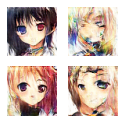

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.6383047699928284
advesarial loss: 0.8865067958831787


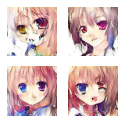

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6824944615364075
advesarial loss: 0.6829211115837097


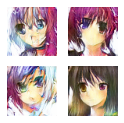

2/2 [==============================] - 0s 82ms/step


discriminator loss: 0.5715758800506592
advesarial loss: 1.646596074104309


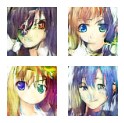

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.7029416561126709
advesarial loss: 1.1259665489196777


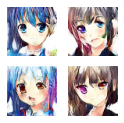

2/2 [==============================] - 0s 78ms/step


discriminator loss: 0.624607264995575
advesarial loss: 1.052480936050415


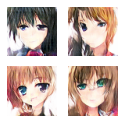

2/2 [==============================] - 0s 80ms/step


discriminator loss: 0.6509597897529602
advesarial loss: 1.0609850883483887


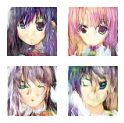

2/2 [==============================] - 0s 86ms/step


discriminator loss: 0.91716468334198
advesarial loss: 2.1533851623535156


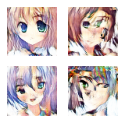

2/2 [==============================] - 0s 79ms/step


In [13]:
for step in tqdm_notebook(range(iterations)):
  random_latent_vectors = np.random.normal(size = (batch_size, latent_dim))
  generated_images = generator.predict(random_latent_vectors)
  stop = start + batch_size
  real_images = x_train[start: stop]
  combined_images = np.concatenate([generated_images, real_images])
  labels = np.concatenate([np.ones((batch_size,1)), 
                                    np.zeros((batch_size, 1))])
  labels += 0.05 * np.random.random(labels.shape)
  
  d_loss = discriminator.train_on_batch(combined_images, labels)
  
  random_latent_vectors = np.random.normal(size=(batch_size, 
                                                 latent_dim))
  misleading_targets = np.zeros((batch_size, 1))
  a_loss = gan.train_on_batch(random_latent_vectors, 
                              misleading_targets)
  start += batch_size
  
  if start > len(x_train) - batch_size:
    start = 0
 
  if step % 10 == 0:
    print('discriminator loss:', d_loss)
    print('advesarial loss:', a_loss)
    fig, axes = plt.subplots(2, 2)
    fig.set_size_inches(2,2)
    count = 0
    for i in range(2):
      for j in range(2):
        axes[i, j].imshow(resize(generated_images[count], (64,64)))
        axes[i, j].axis('off')
        count += 1
    plt.show()
    
  if step % 100 == 0:
    # Save the weight. If you want to train for a long time, make sure to save 
    # in your drive. Mount your drive here. Google on how to mount your drive
    # into colab
    gan.save_weights('model.h5')
    
    print('discriminator loss:', d_loss)
    print('advesarial loss:', a_loss)
    